<a href="https://colab.research.google.com/github/ovieimara/ITNPBD4/blob/master/Predict_Hotel_booking_status.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install ydata-profiling

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score
from sklearn.tree import DecisionTreeRegressor  # For regression
from sklearn.tree import DecisionTreeClassifier  # For classification
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from tensorflow import keras
from tensorflow.keras import layers, regularizers
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.utils.class_weight import compute_class_weight
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from ydata_profiling import ProfileReport

In [ ]:
#read csv file
hotel_bookings = "hotel_bookings.csv"
# H2 = "H2.csv"
# H1 = "H1.csv"

In [ ]:
hotel_booking_df = pd.read_csv(hotel_bookings)
# H1_df = pd.read_csv(H1)
# H2_df = pd.read_csv(H2)


In [ ]:

def profile_report_generator(df, title):
  profile_report = ProfileReport(df, title = title)
  profile_report.config.html.full_width = True
  profile_report.to_notebook_iframe()
  return profile_report

# profile_report_generator(hotel_booking_df, "Hotel Bookings Profile Data")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

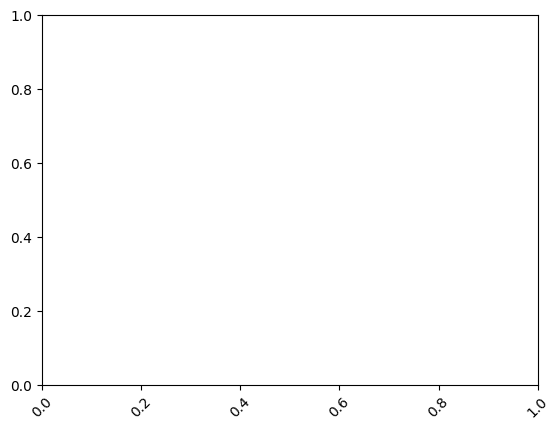

In [ ]:
import io


hotel_booking_df.info(show_counts=True)  # Include show_counts argument
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
fig = plt.gcf()
fig.savefig("hotel_booking_info.png")

# profile_report_generator(hotel_booking_df.info(), "Hotel Bookings Profile Data")

In [ ]:
profile_report_generator(hotel_booking_df, '')
# H1_df.describe()
# H2_df.describe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
from tabulate import tabulate

# summary = hotel_booking_df[["Impressions_control","Impressions_test"]].describe().T
print(tabulate(hotel_booking_df.iloc[:, [2, 4, 5, 6]].head(), headers='keys', floatfmt=".2f", tablefmt="grid"))

+----+-------------+----------------------+----------------------------+-----------------------------+
|    |   lead_time | arrival_date_month   |   arrival_date_week_number |   arrival_date_day_of_month |
+====+=============+======================+============================+=============================+
|  0 |         342 | July                 |                         27 |                           1 |
+----+-------------+----------------------+----------------------------+-----------------------------+
|  1 |         737 | July                 |                         27 |                           1 |
+----+-------------+----------------------+----------------------------+-----------------------------+
|  2 |           7 | July                 |                         27 |                           1 |
+----+-------------+----------------------+----------------------------+-----------------------------+
|  3 |          13 | July                 |                         27 | 

In [ ]:
hotel_booking_df.isna().sum()
hotel_booking_df.isna().sum()
# H2_df['Country'].isna().sum()
hotel_booking_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

Fill NaNs with 0

In [ ]:
hotel_booking_df['agent'] = hotel_booking_df['agent'].fillna(0)
hotel_booking_df['children'] = hotel_booking_df['children'].fillna(0)
hotel_booking_df['company'] = hotel_booking_df['company'].fillna(0)
hotel_booking_df['country'] = hotel_booking_df['country'].fillna('Unknown')

In [ ]:
#density plots
# hotel_booking_df['market_segment'].value_counts()
# sns.displot(hotel_booking_df['market_segment'])
# plt.xticks(rotation=90)
# sns..boxplot(hotel_booking_df['market_segment'])
#create box plot, displot, violin plot and histogram plots in a figure

def create_plots(df, col):
    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    sns.boxplot(df[col], ax=ax[0, 0])
    sns.violinplot(df[col], ax=ax[0, 1])
    sns.countplot(df[col], ax=ax[1, 0], order=df[col].value_counts().index)
    sns.histplot(df[col], ax=ax[1, 1], bins="auto", kde=True)
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()




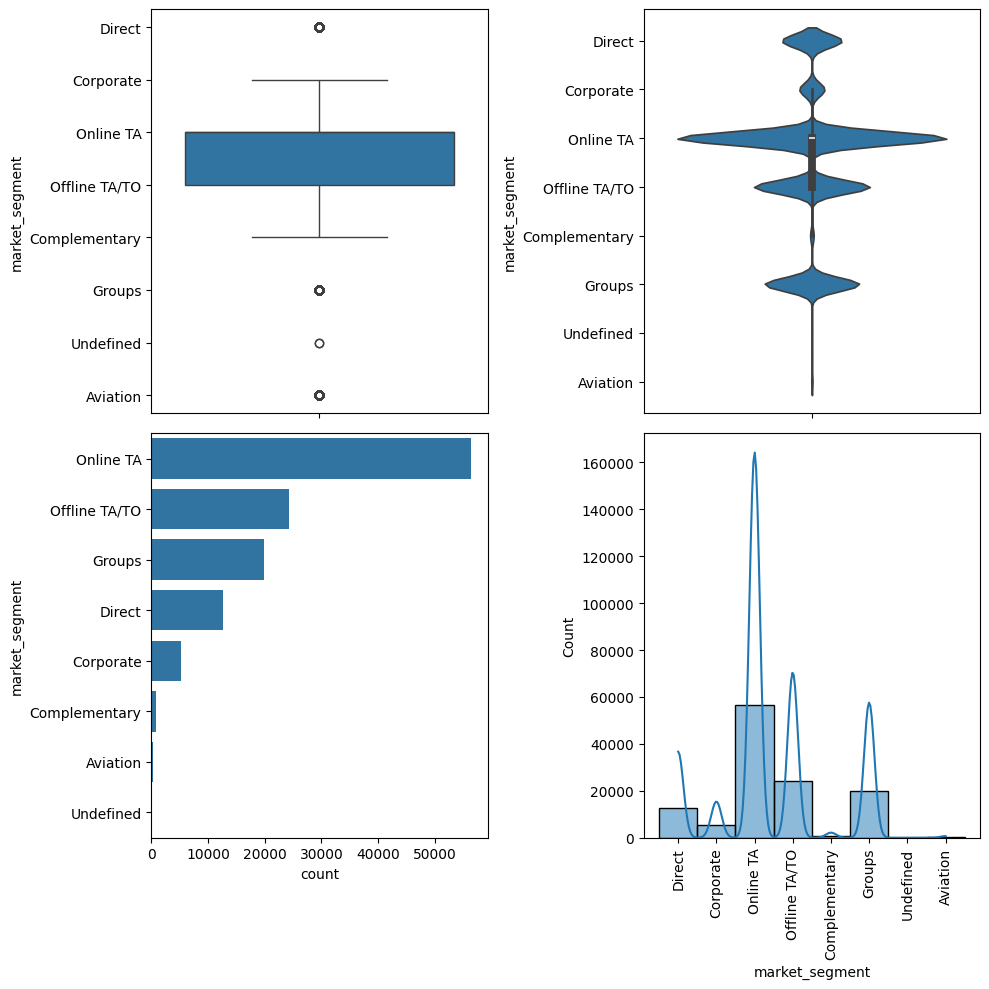

In [ ]:
column = "market_segment"
create_plots(hotel_booking_df, column)


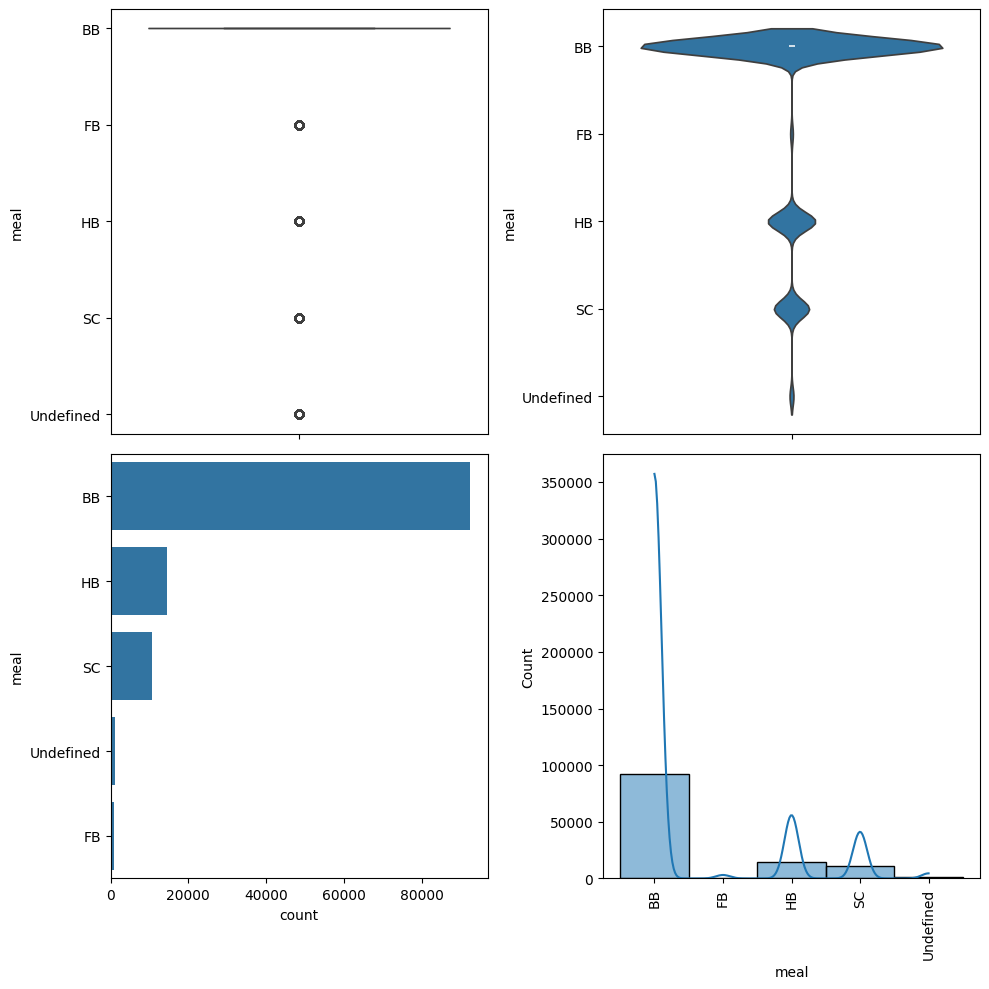

In [ ]:
column = "meal"
create_plots(hotel_booking_df, column)

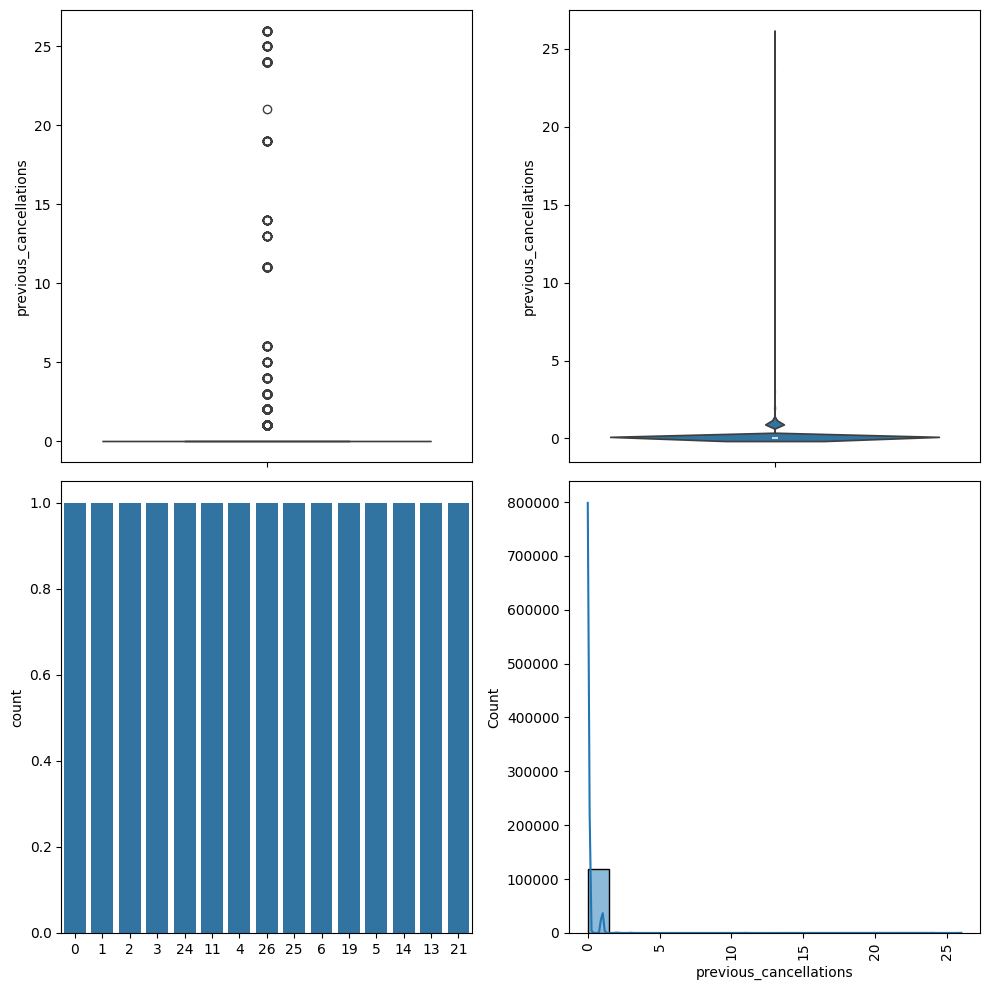

In [ ]:
column = "previous_cancellations"
create_plots(hotel_booking_df, column)


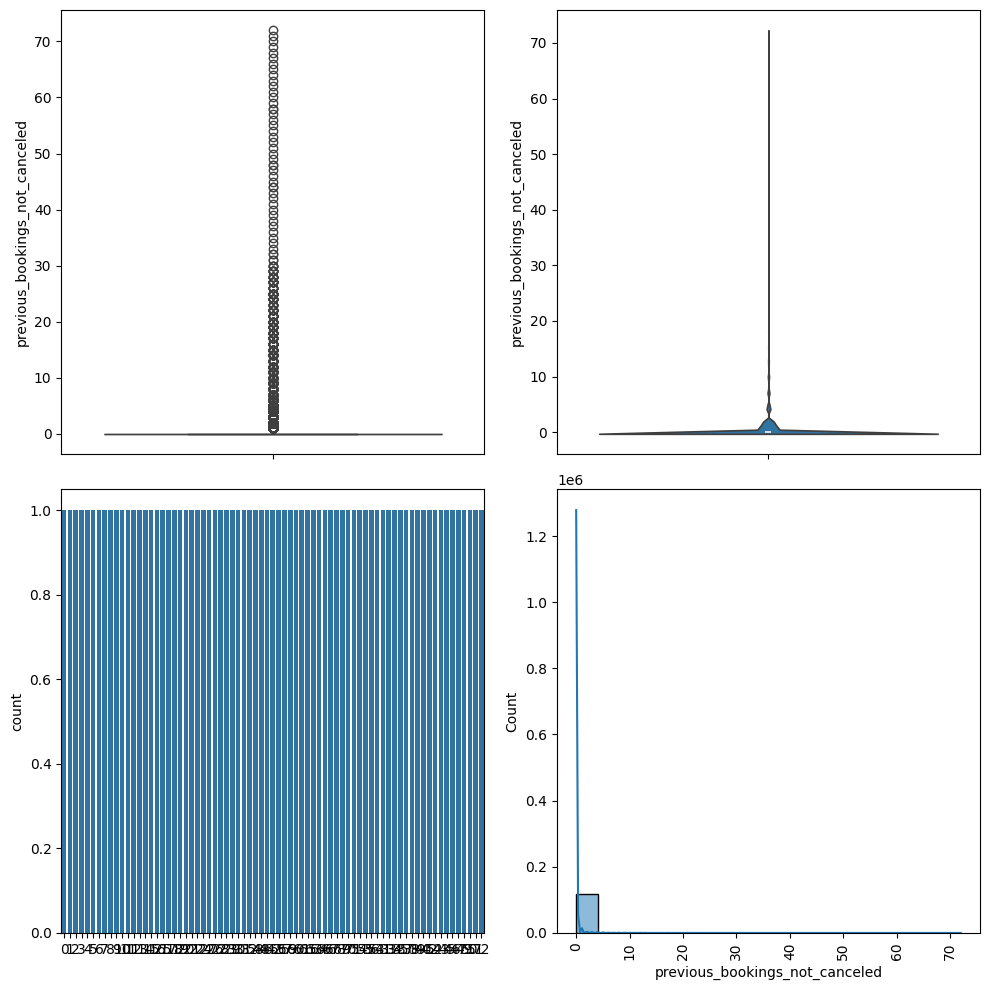

In [ ]:
column = "previous_bookings_not_canceled"
create_plots(hotel_booking_df, column)

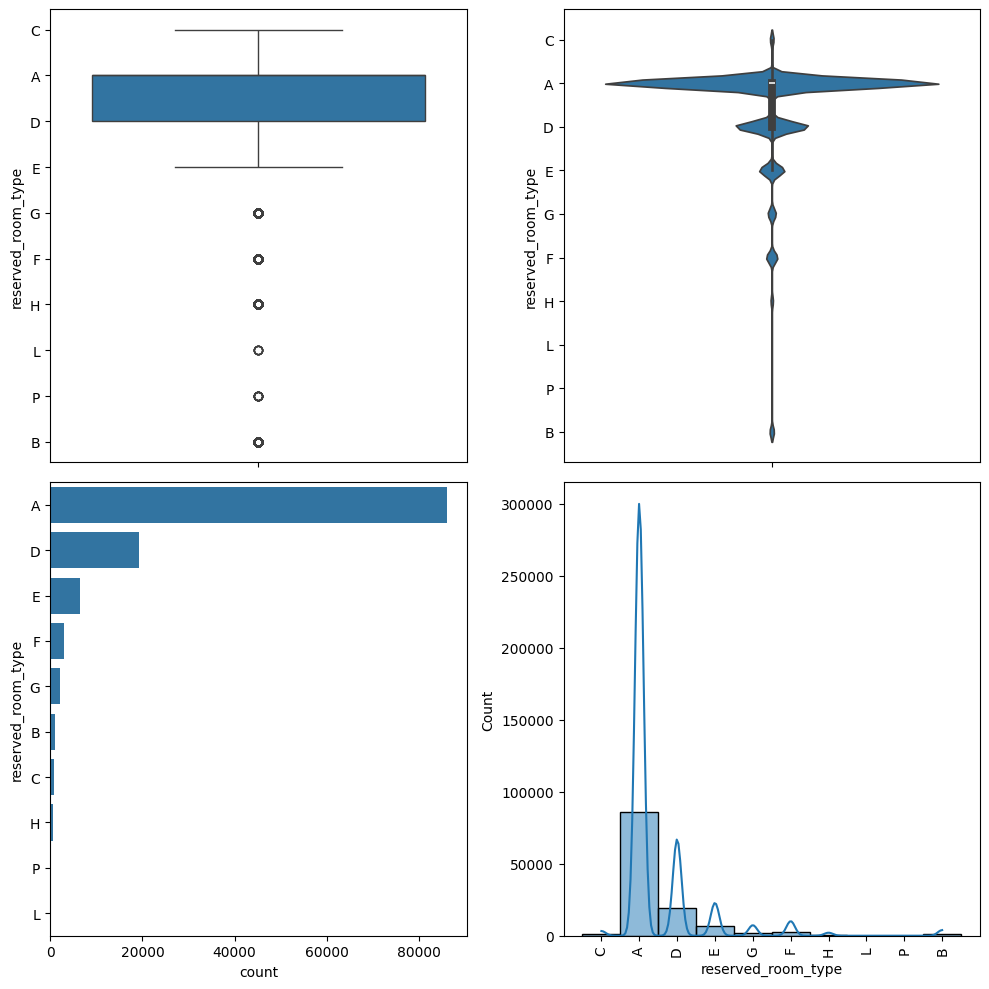

In [ ]:
column = "reserved_room_type"
create_plots(hotel_booking_df, column)

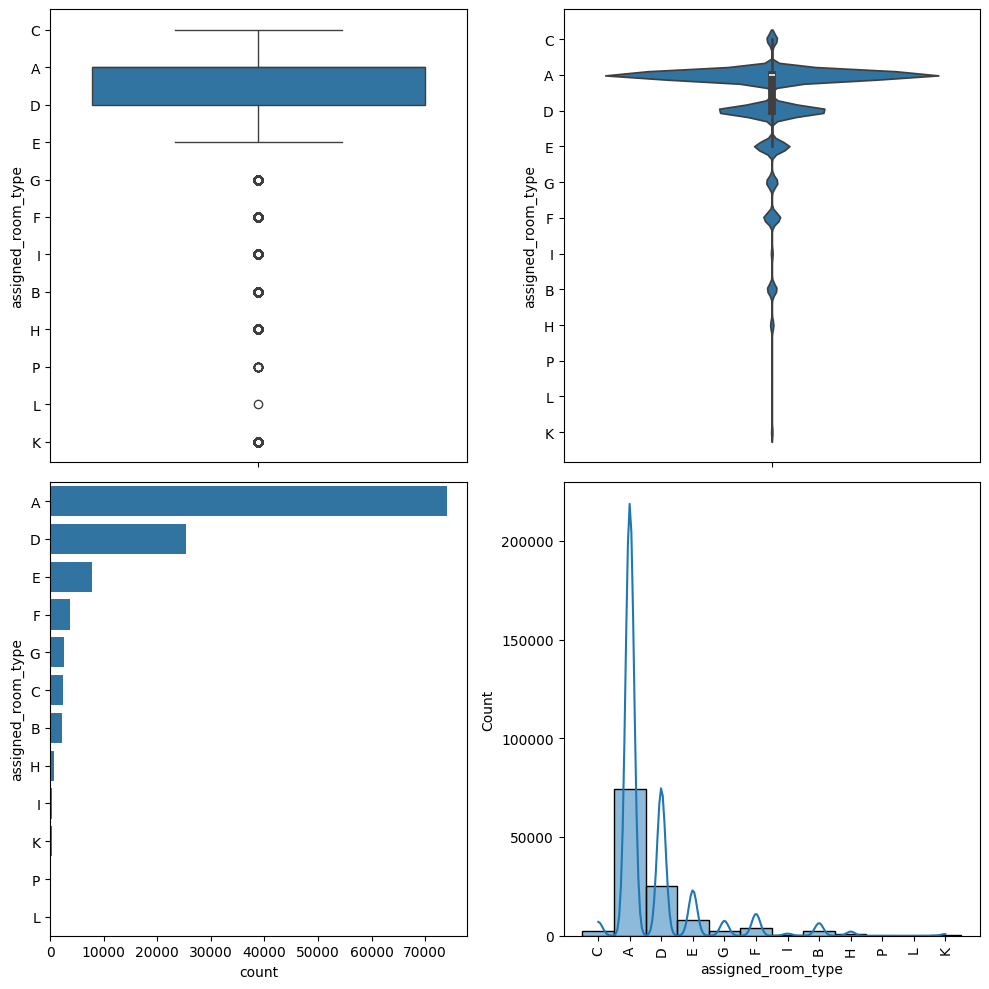

In [ ]:
column = "assigned_room_type"
create_plots(hotel_booking_df, column)

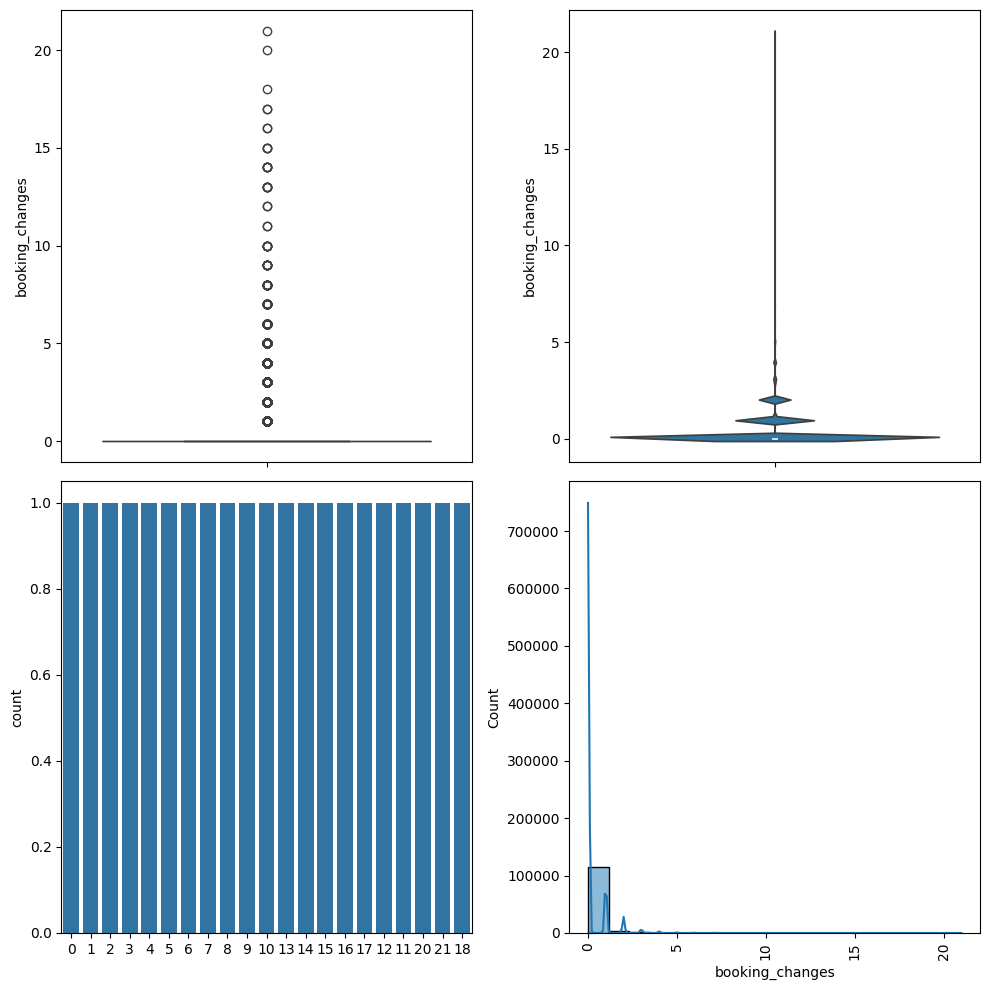

In [ ]:
column = "booking_changes"
create_plots(hotel_booking_df, column)

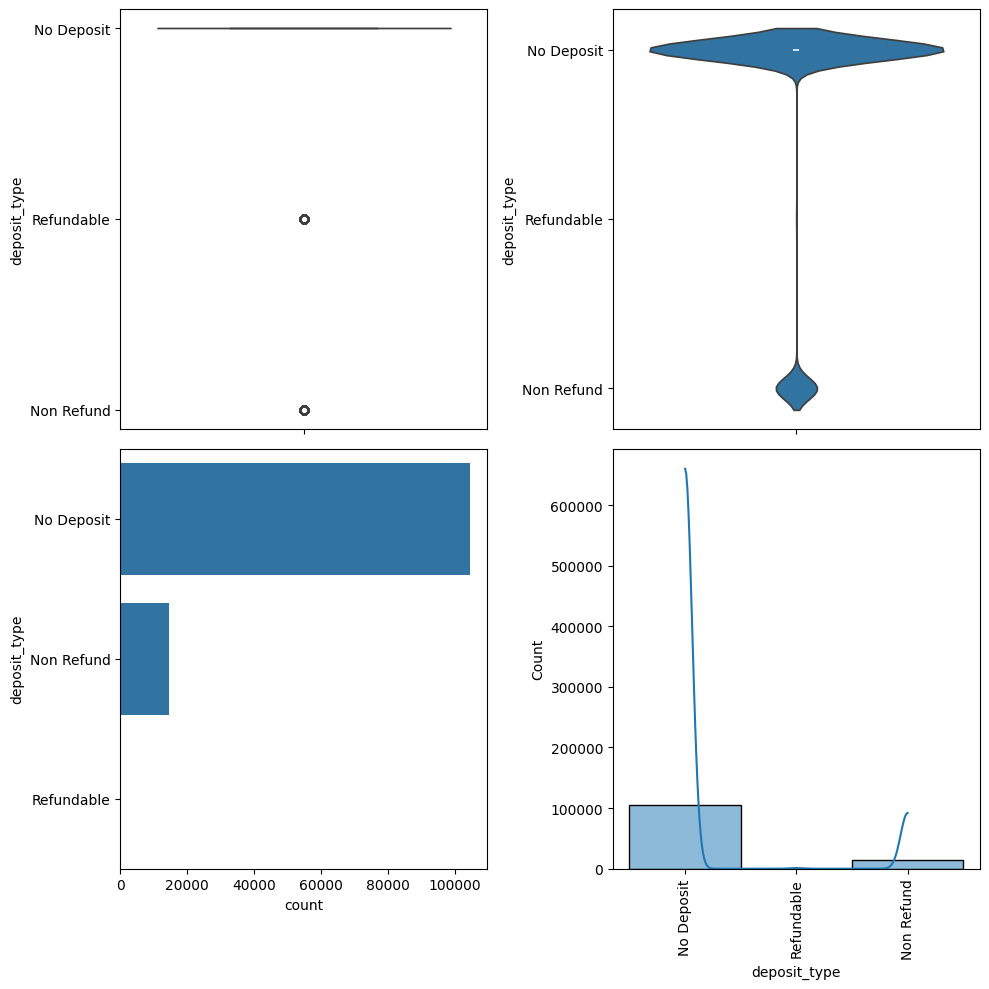

In [ ]:
column = "deposit_type"
create_plots(hotel_booking_df, column)

remove NaN's

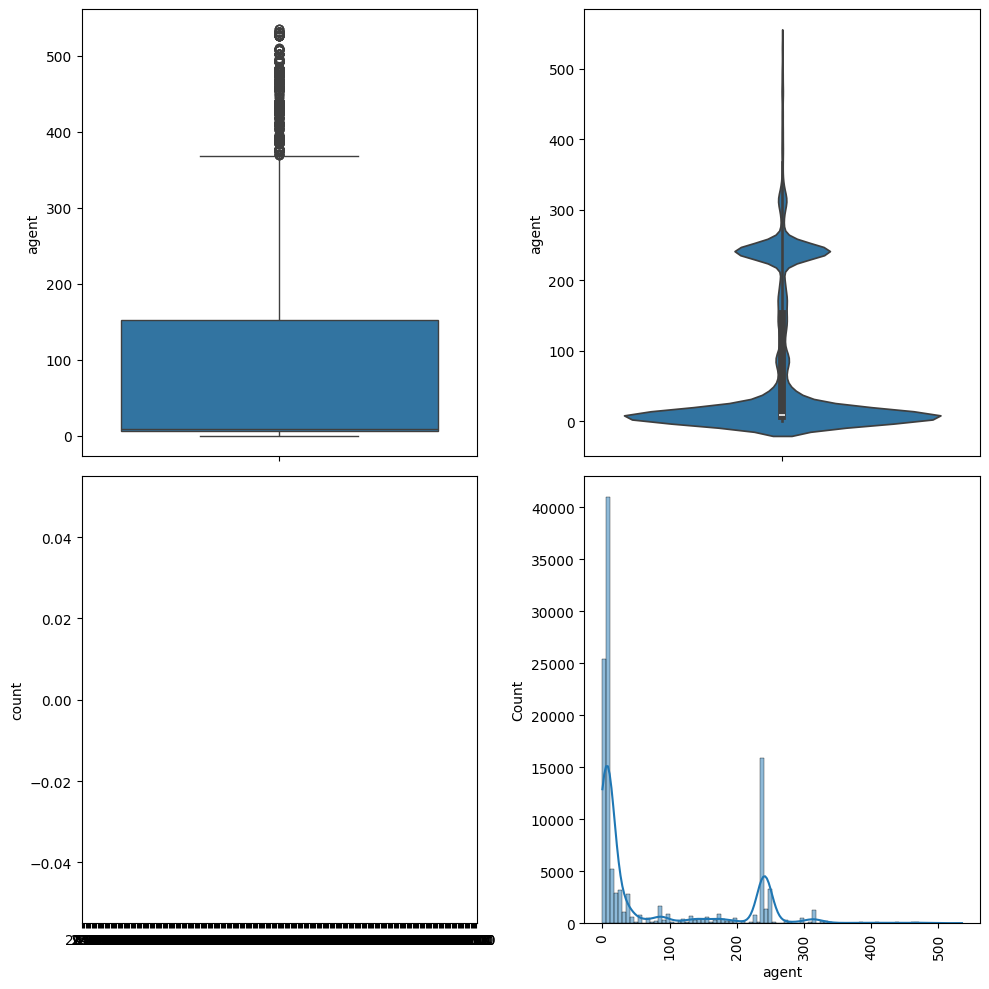

In [ ]:
column = "agent"
create_plots(hotel_booking_df, column)


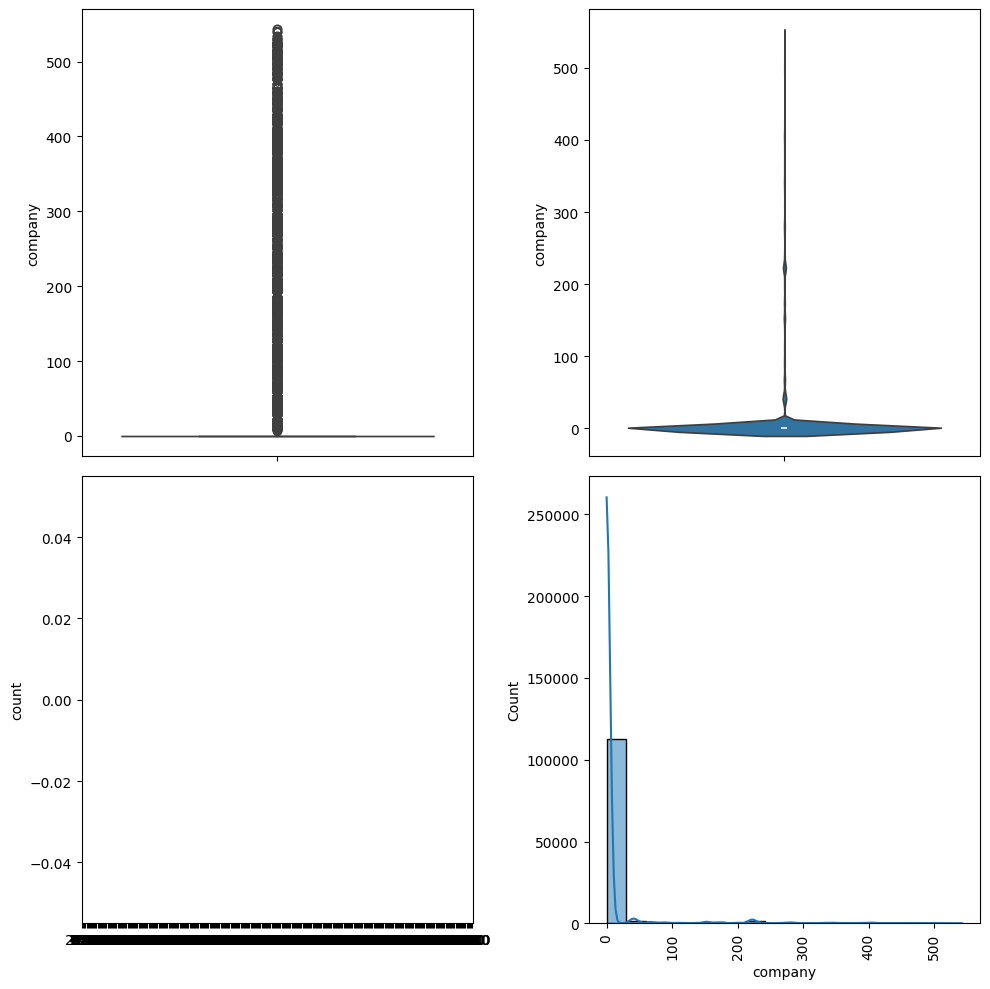

In [ ]:
column = "company"
create_plots(hotel_booking_df, column)

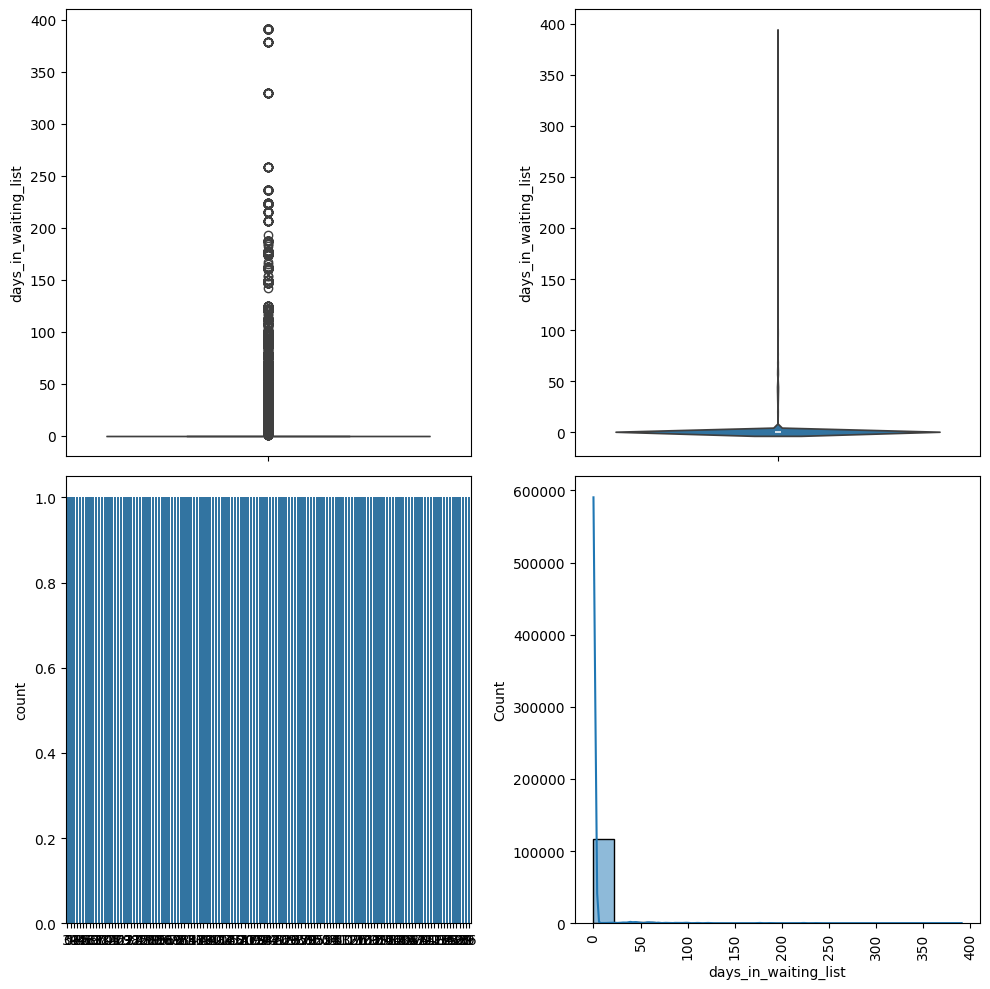

In [ ]:
column = "days_in_waiting_list"
# hotel_booking_df['days_in_waiting_list'].isna().sum()
# hotel_booking_df['agent'] = hotel_booking_df['agent'].fillna(0)
create_plots(hotel_booking_df, column)

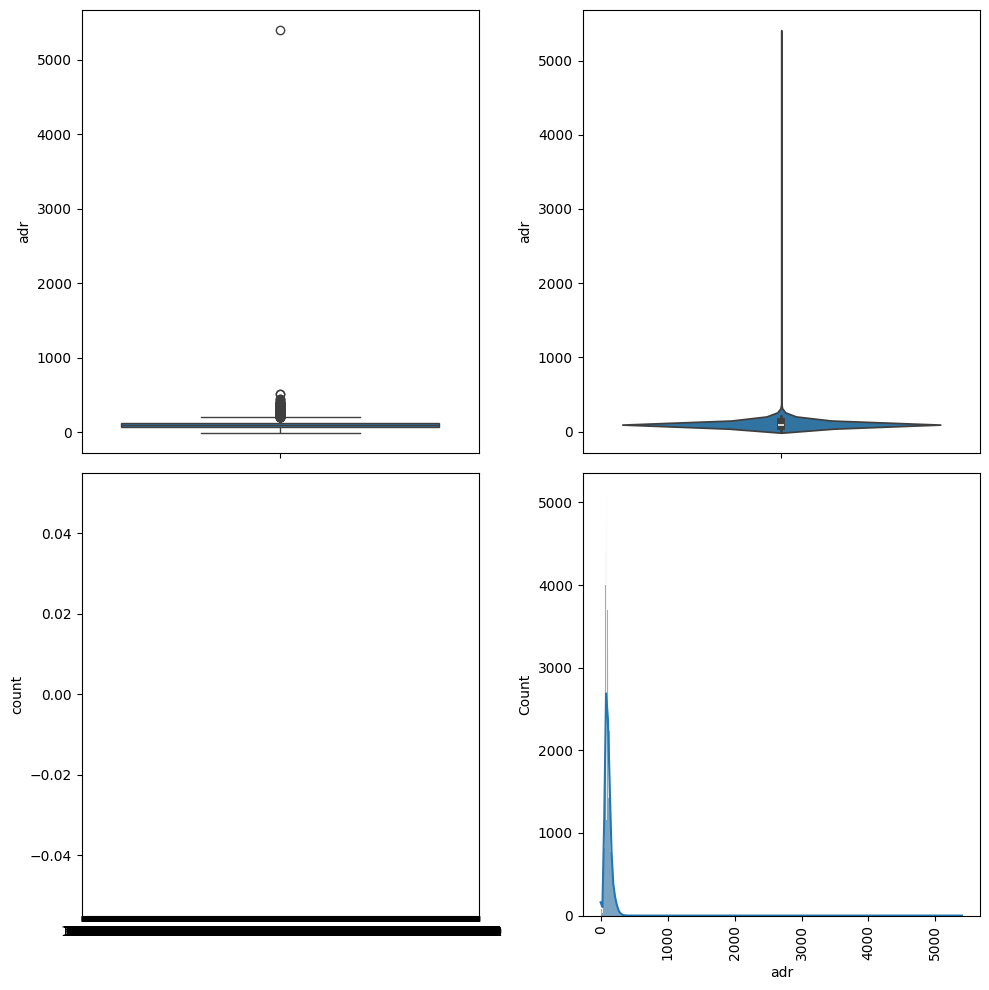

In [ ]:
column = "adr"
# hotel_booking_df['adr'].isna().sum()
# hotel_booking_df['adr'] = hotel_booking_df['adr'].fillna(0)
create_plots(hotel_booking_df, column)
# hotel_booking_df['adr'].describe()

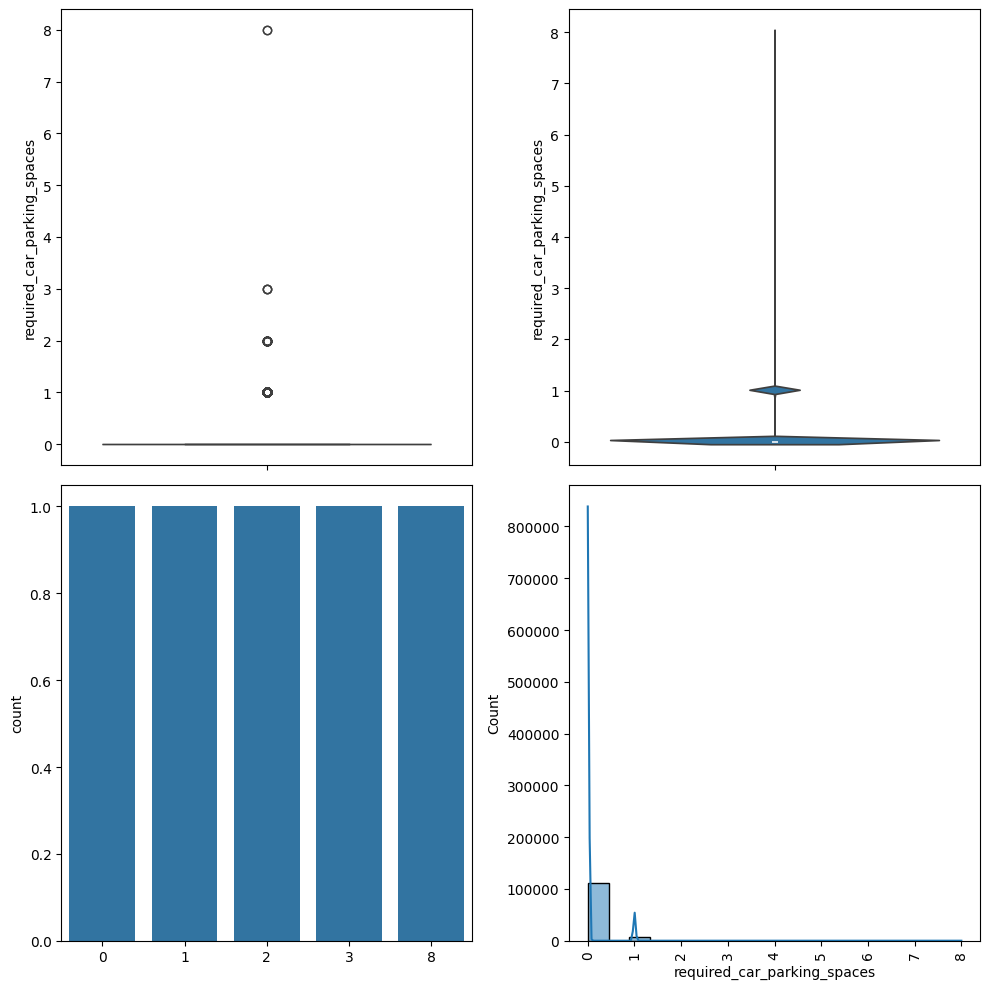

In [ ]:
column = "required_car_parking_spaces"
# hotel_booking_df['adr'].isna().sum()
# hotel_booking_df['adr'] = hotel_booking_df['adr'].fillna(0)
create_plots(hotel_booking_df, column)

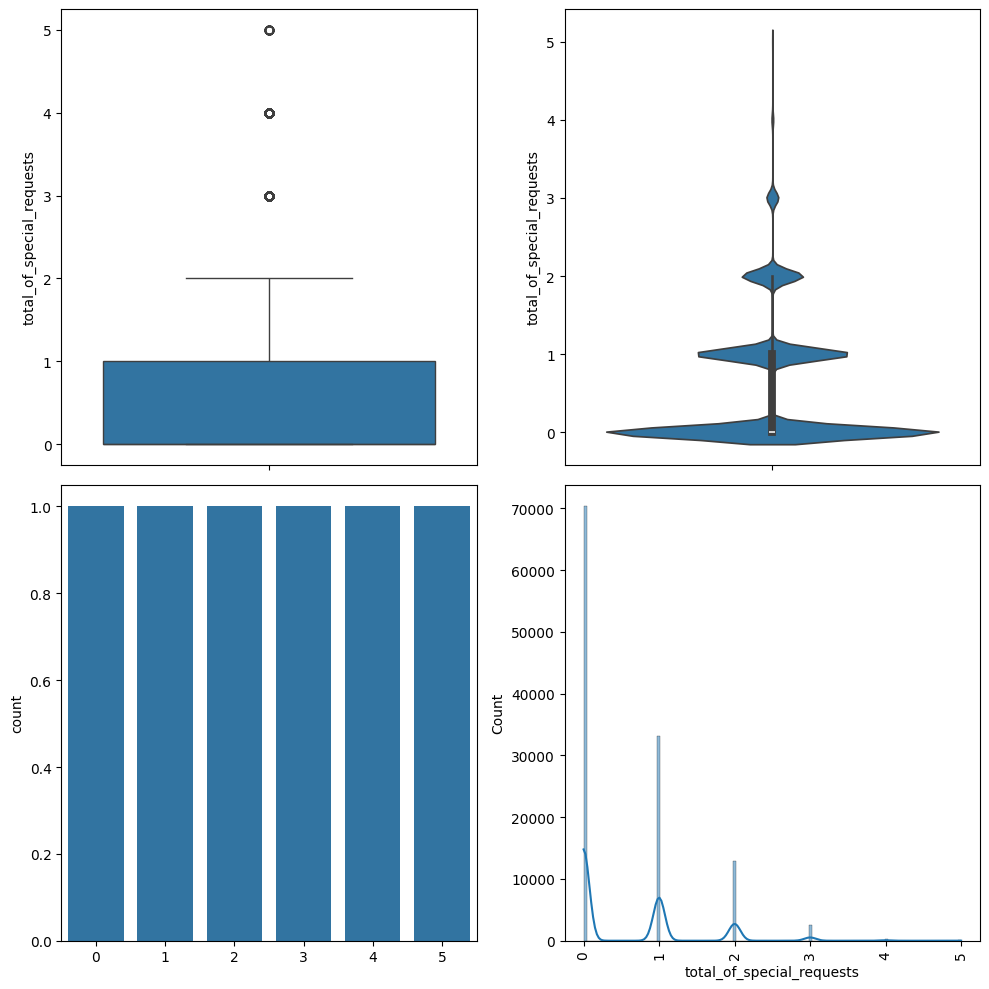

In [ ]:
column = "total_of_special_requests"
# hotel_booking_df['adr'].isna().sum()
# hotel_booking_df['adr'] = hotel_booking_df['adr'].fillna(0)
create_plots(hotel_booking_df, column)

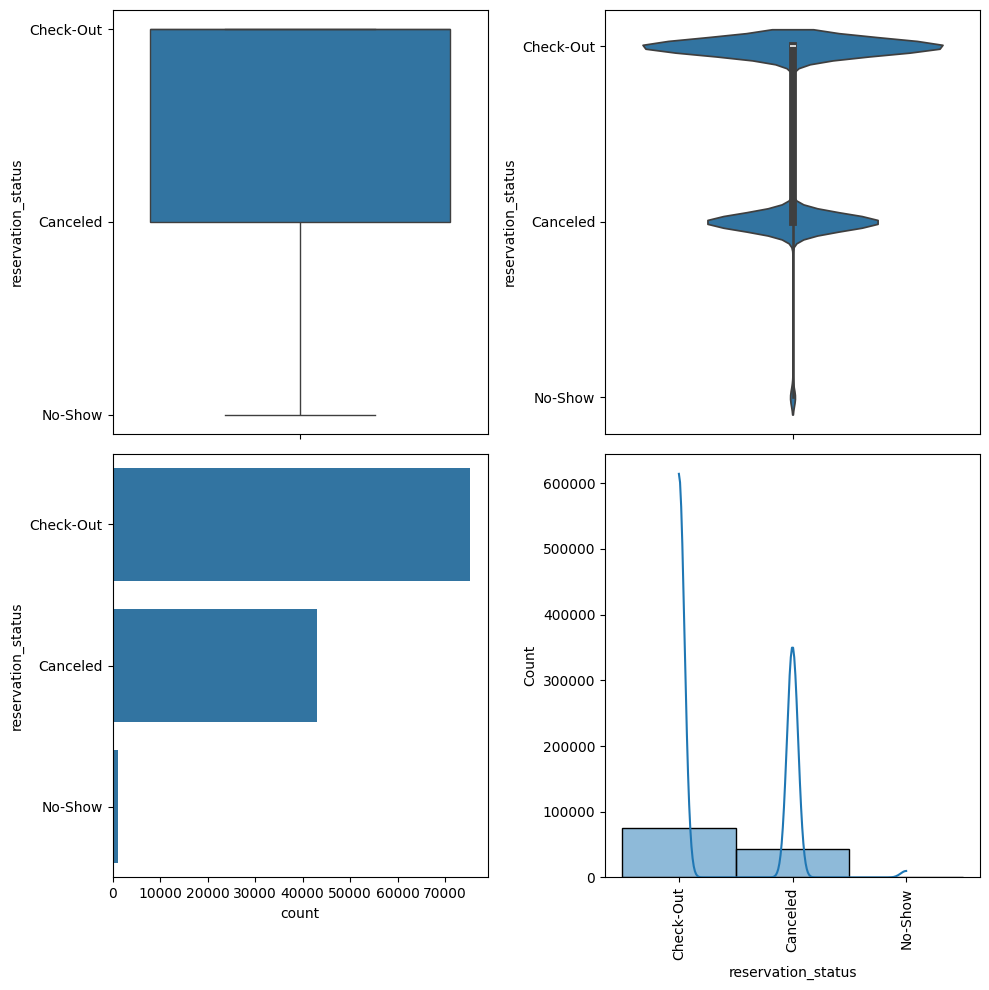

In [ ]:
column = "reservation_status"
# hotel_booking_df['adr'].isna().sum()
# hotel_booking_df['adr'] = hotel_booking_df['adr'].fillna(0)
create_plots(hotel_booking_df, column)

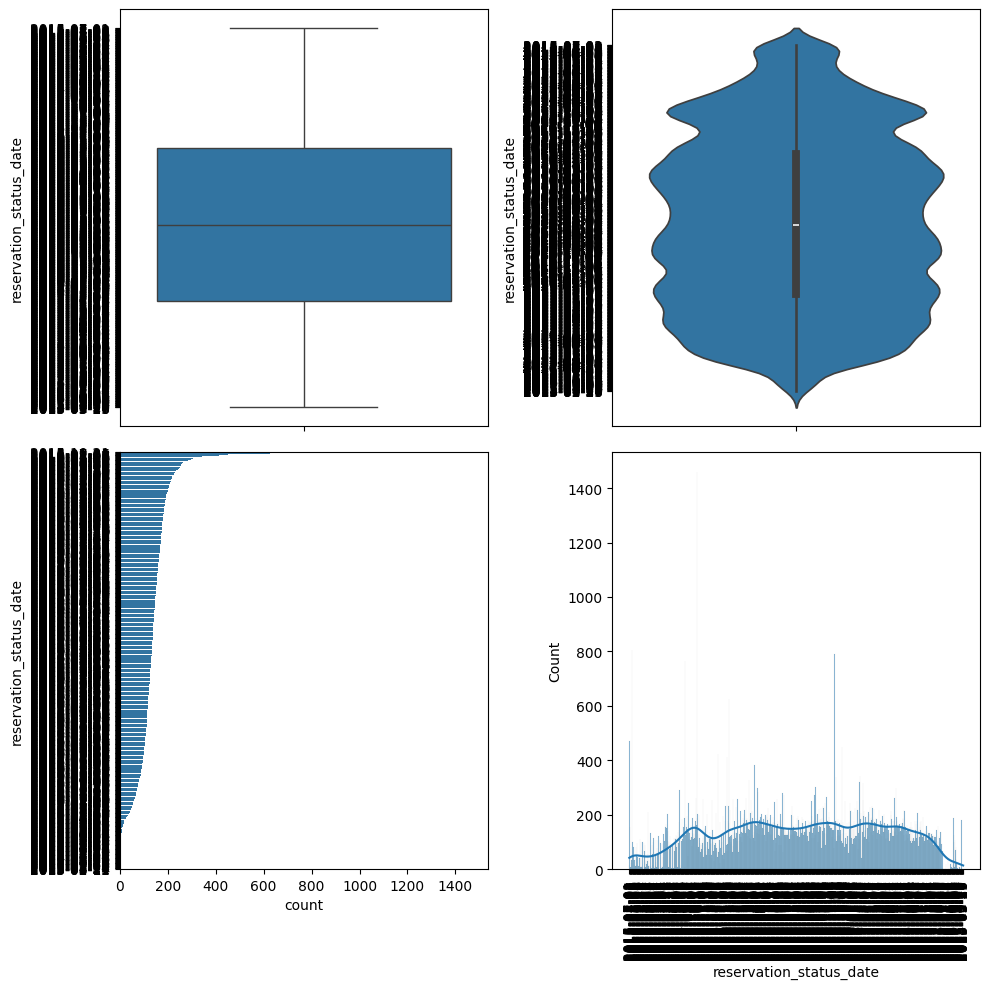

In [ ]:
column = "reservation_status_date"
# hotel_booking_df['adr'].isna().sum()
# hotel_booking_df['adr'] = hotel_booking_df['adr'].fillna(0)
create_plots(hotel_booking_df, column)

In [ ]:
def plot_country_distribution(df, column):
    countries = df.groupby(column).size().reset_index(name='count')
    figure = px.choropleth(
        countries,
        locations="country",
        color="count",
        hover_name="country",
        title="Guest Countries Distribution",
        color_continuous_scale=px.colors.sequential.Turbo_r
        # color_continuous_scale=px.colors.sequential.Plasma,
    )

    figure.show()

plot_country_distribution(hotel_booking_df, "country")


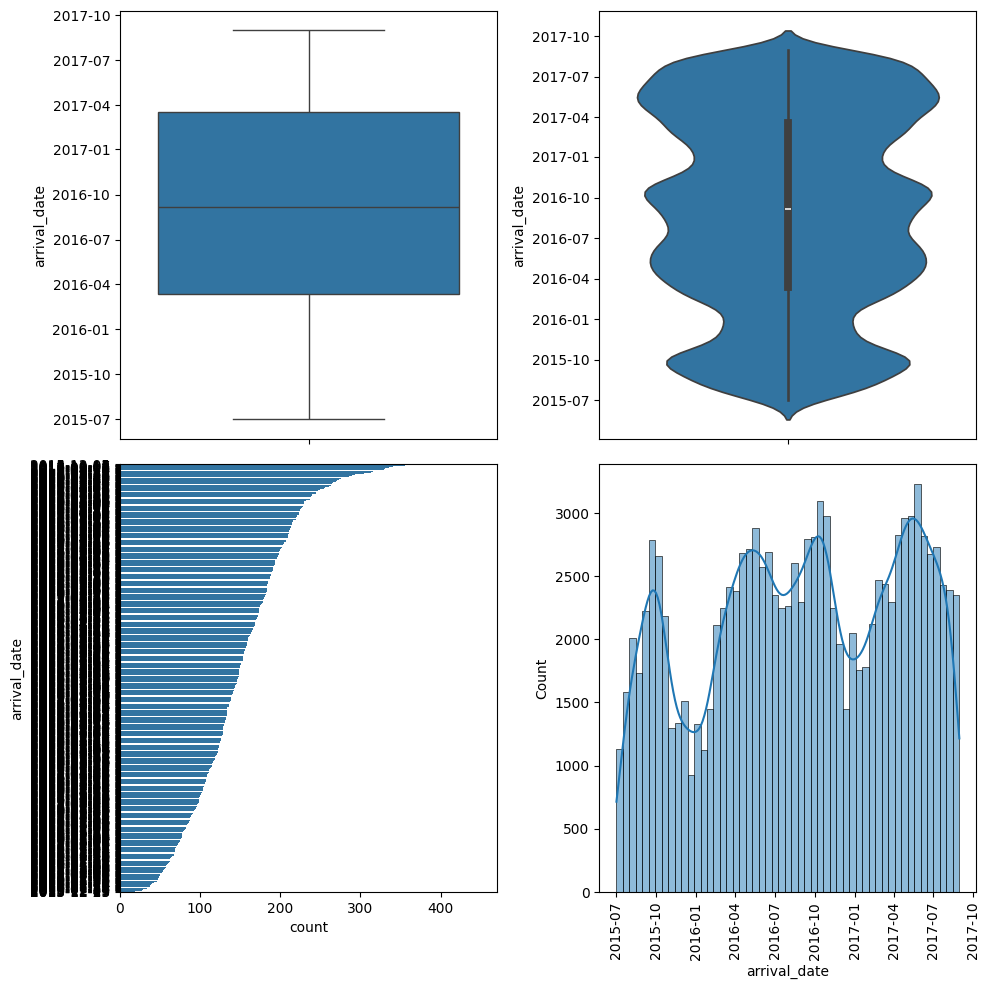

In [ ]:
#create a new column from the arrival_date_day_of_month, arrival_date_month, arrival_date_year columns
hotel_booking_df['arrival_date'] = pd.to_datetime(hotel_booking_df['arrival_date_day_of_month'].astype(str) + '-' + hotel_booking_df['arrival_date_month'].astype(str) + '-' + hotel_booking_df['arrival_date_year'].astype(str), format='%d-%B-%Y')
# hotel_booking_df['arrival_date']
create_plots(hotel_booking_df, "arrival_date")

In [ ]:
hotel_booking_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 33 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   hotel                           119390 non-null  object        
 1   is_canceled                     119390 non-null  int64         
 2   lead_time                       119390 non-null  int64         
 3   arrival_date_year               119390 non-null  int64         
 4   arrival_date_month              119390 non-null  object        
 5   arrival_date_week_number        119390 non-null  int64         
 6   arrival_date_day_of_month       119390 non-null  int64         
 7   stays_in_weekend_nights         119390 non-null  int64         
 8   stays_in_week_nights            119390 non-null  int64         
 9   adults                          119390 non-null  int64         
 10  children                        119390 non-null  float64

**Data Transformations**

In [ ]:
#data Transformations
hotel_booking_df['meal_encoded'] = hotel_booking_df['meal'].map({'BB': 0, 'HB': 1, 'FB': 2, 'SC': 3, 'Undefined': 3})
hotel_booking_df['market_segment_encoded'] = hotel_booking_df['market_segment'].map({'Online TA': 0, 'Direct': 1, 'Corporate': 2, 'Groups': 3, 'Undefined': 4, 'Offline TA/TO': 5, 'Complementary': 6, 'Aviation': 7})
hotel_booking_df['distribution_channel_encoded'] = hotel_booking_df['distribution_channel'].map({'TA/TO': 0, 'Direct': 1, 'Corporate': 2, 'GDS': 3, 'Undefined': 4})
hotel_booking_df['reserved_room_type_encoded'] = hotel_booking_df['reserved_room_type'].map({'A': 0, 'D': 1, 'E': 2, 'B': 3, 'C': 4, 'F': 5, 'G': 6, 'H': 7, 'L': 8, 'P': 9})
hotel_booking_df['deposit_type_encoded'] = hotel_booking_df['deposit_type'].map({'No Deposit': 0, 'Non Refund': 1, 'Refundable': 2})
hotel_booking_df['customer_type_encoded'] = hotel_booking_df['customer_type'].map({'Transient': 0, 'Transient-Party': 1, 'Contract': 2, 'Group': 3})
hotel_booking_df['reservation_status_encoded'] = hotel_booking_df['reservation_status'].map({'Check-Out': 0, 'Canceled': 1, 'No-Show': 2})
hotel_booking_df['reservation_status_date'] = pd.to_datetime(hotel_booking_df['reservation_status_date'], format='%Y-%m-%d')
hotel_booking_df['hotel_encoded'] = hotel_booking_df['hotel'].map({'City Hotel': 0, 'Resort Hotel': 1})

#extracting day, month, week number and year from reservation_status_date
hotel_booking_df['reservation_status_day'] = hotel_booking_df['reservation_status_date'].dt.day
hotel_booking_df['reservation_status_month'] = hotel_booking_df['reservation_status_date'].dt.month
hotel_booking_df['reservation_status_week'] = hotel_booking_df['reservation_status_date'].dt.isocalendar().week
hotel_booking_df['reservation_status_year'] = hotel_booking_df['reservation_status_date'].dt.year

In [ ]:
label_encoder = LabelEncoder()
hotel_booking_df['country_encoded'] = label_encoder.fit_transform(hotel_booking_df['country'])
hotel_booking_df['assigned_room_type_encoded'] = label_encoder.fit_transform(hotel_booking_df['assigned_room_type'])


**Bivariate Analysis:**

Analyze the relationship between pairs of variables (e.g., scatter plots, correlation matrices)


In [ ]:
#extract numerical colums from dataframe
def extract_numerical_columns(df):
    numerical_columns = df.select_dtypes(include=[np.number])
    return numerical_columns

#extract categorical columns from dataframe
def extract_categorical_columns(df):
    categorical_columns = df.select_dtypes(include=[object])
    return categorical_columns

hotel_booking_num_df = extract_numerical_columns(hotel_booking_df)
hotel_booking_cat_df = extract_categorical_columns(hotel_booking_df)


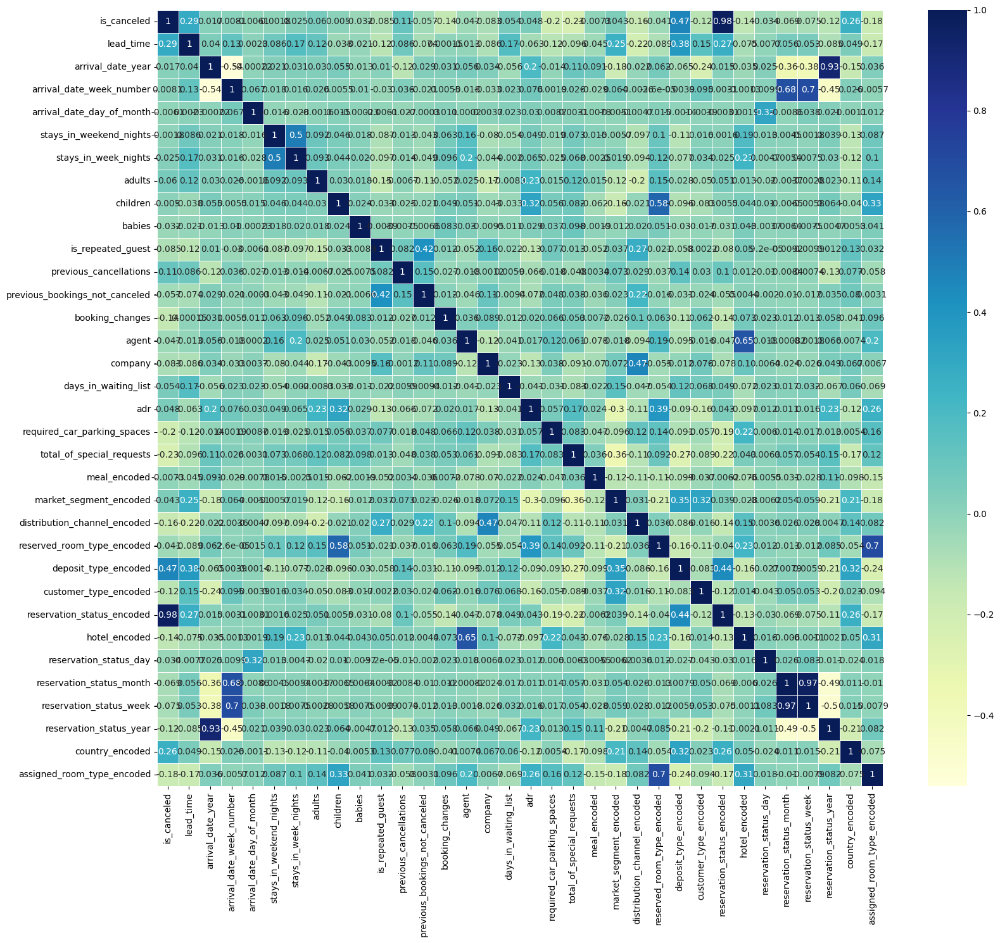

In [ ]:
def plot_column_correlations(df, size=10):
    corr = df.corr()
    # sns.pairplot(df, height = 5, aspect=1)
    plt.figure(figsize=(17, 15))
    sns.heatmap(corr, cmap="YlGnBu", annot=True, linewidths=.5)
    plt.tight_layout()
    plt.show()

plot_column_correlations(hotel_booking_num_df)


In [ ]:
label_scaler = StandardScaler()

# Scale the features
X_scaled_df = label_scaler.fit_transform(hotel_booking_num_df)


In [ ]:

def plot_distributions(df: pd.DataFrame, x: str, y: str, fig_width: int = 14, fig_height: int= 5)-> None:
  fig, ax = plt.subplots(1, 3, figsize=(14, 5))
  sns.barplot(x=x, y=y, data=df, ax=ax[0])
  sns.boxplot(x=x, y=y, data=df, ax=ax[1])
  sns.violinplot(x=x, y=y, data=df, ax=ax[2])
  plt.xticks(rotation=90)
  plt.tight_layout()
  plt.show()


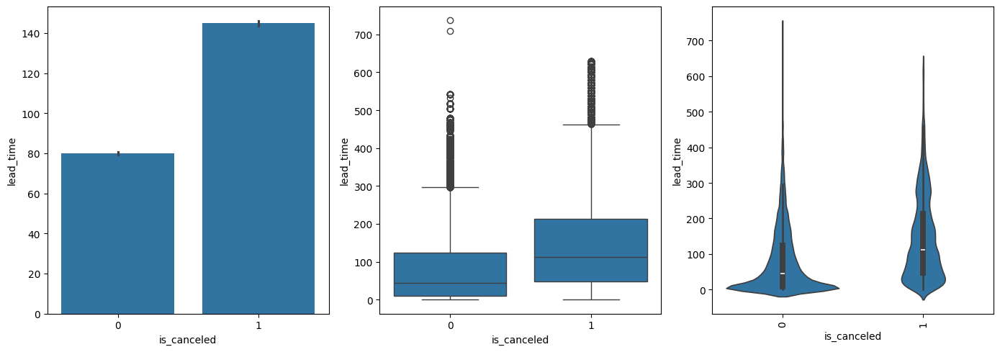

In [ ]:
x = "is_canceled"
y = "lead_time"
plot_distributions(hotel_booking_num_df, x, y)

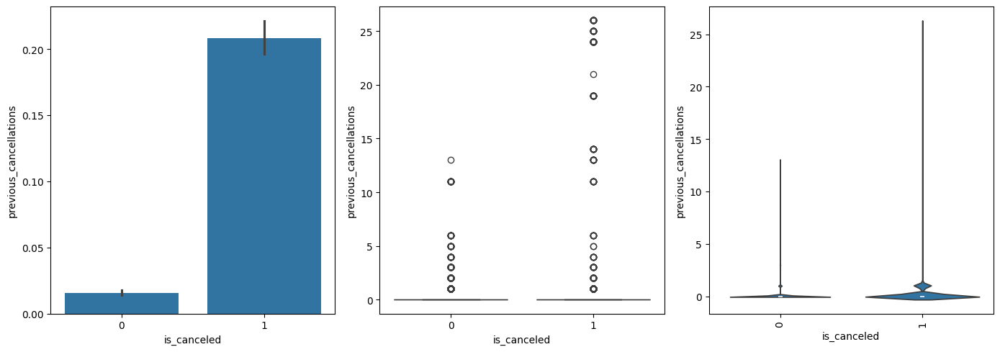

In [ ]:
x = "is_canceled"
y = "previous_cancellations"
plot_distributions(hotel_booking_num_df, x, y)

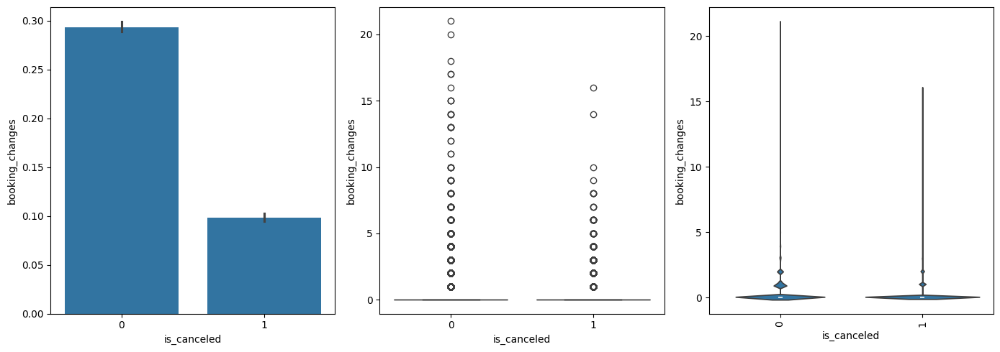

In [ ]:
x = "is_canceled"
y = "booking_changes"
plot_distributions(hotel_booking_num_df, x, y)

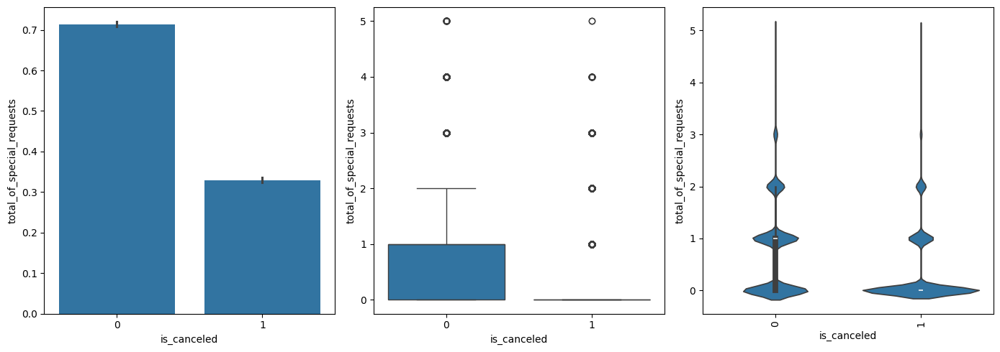

In [ ]:
x = "is_canceled"
y = "total_of_special_requests"
plot_distributions(hotel_booking_num_df, x, y)

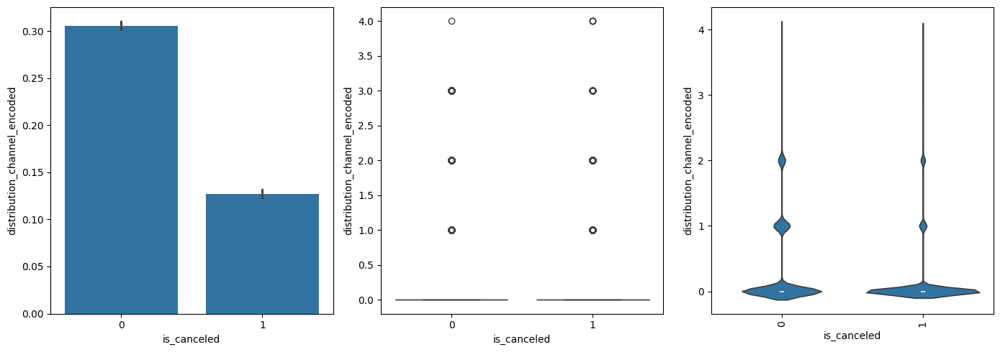

In [ ]:
x = "is_canceled"
y = "distribution_channel_encoded"
plot_distributions(hotel_booking_num_df, x, y)

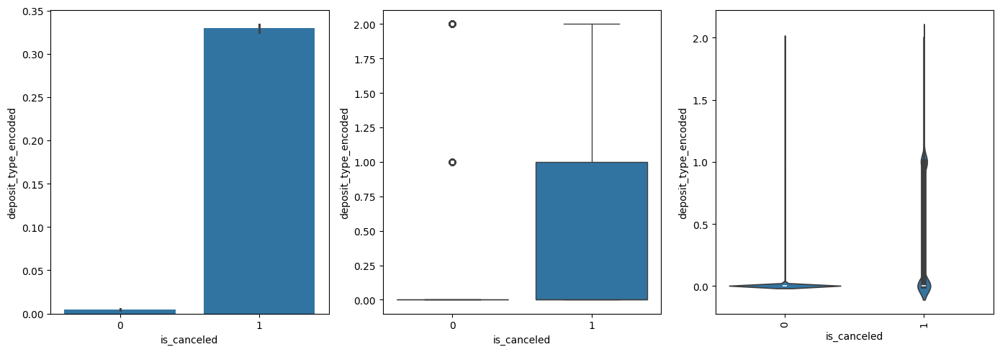

In [ ]:
x = "is_canceled"
y = "deposit_type_encoded"
plot_distributions(hotel_booking_num_df, x, y)

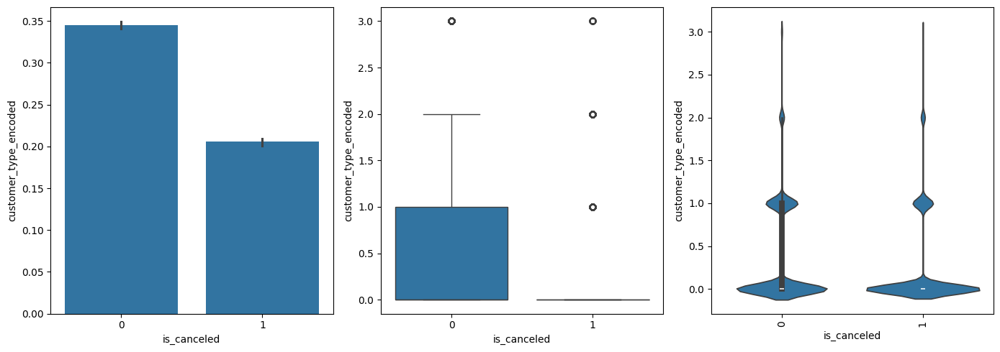

In [ ]:
x = "is_canceled"
y = "customer_type_encoded"
plot_distributions(hotel_booking_num_df, x, y)

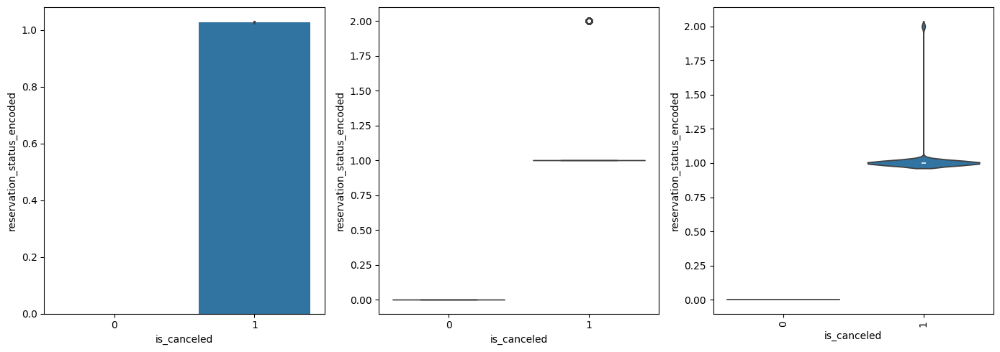

In [ ]:
x = "is_canceled"
y = "reservation_status_encoded"
plot_distributions(hotel_booking_num_df, x, y)

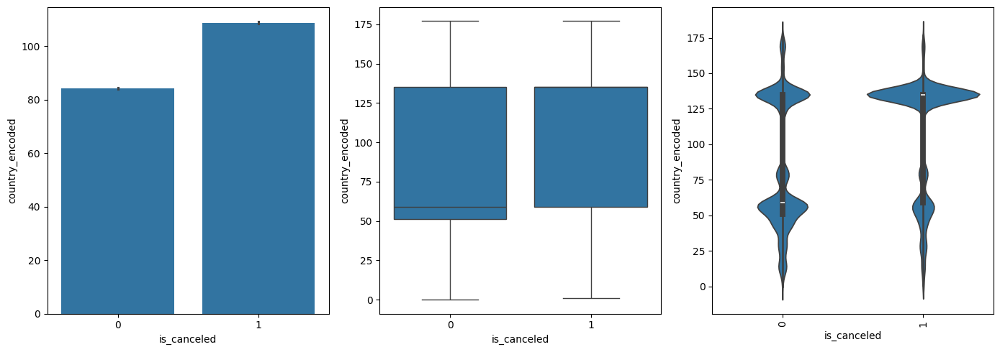

In [ ]:
x = "is_canceled"
y = "country_encoded"
plot_distributions(hotel_booking_num_df, x, y)

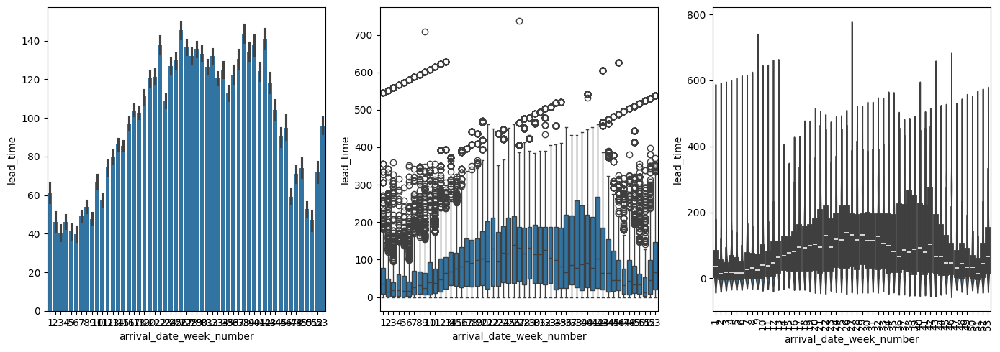

In [ ]:
x = "arrival_date_week_number"
y = "lead_time"
plot_distributions(hotel_booking_num_df, x, y)

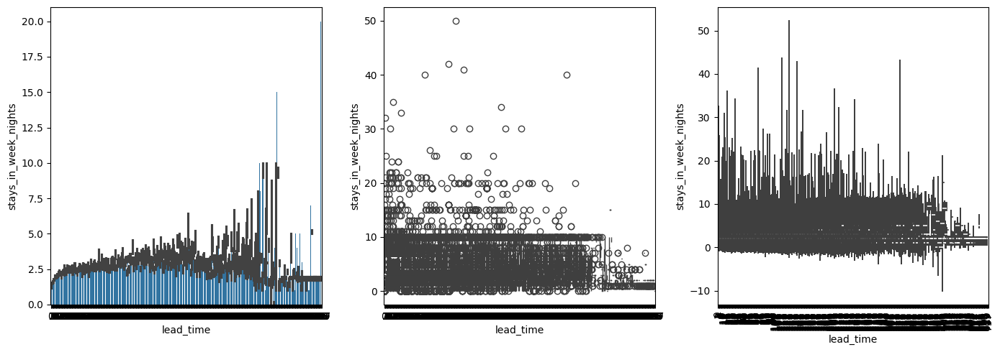

In [ ]:
x = "lead_time"
y = "stays_in_week_nights"
plot_distributions(hotel_booking_num_df, x, y)

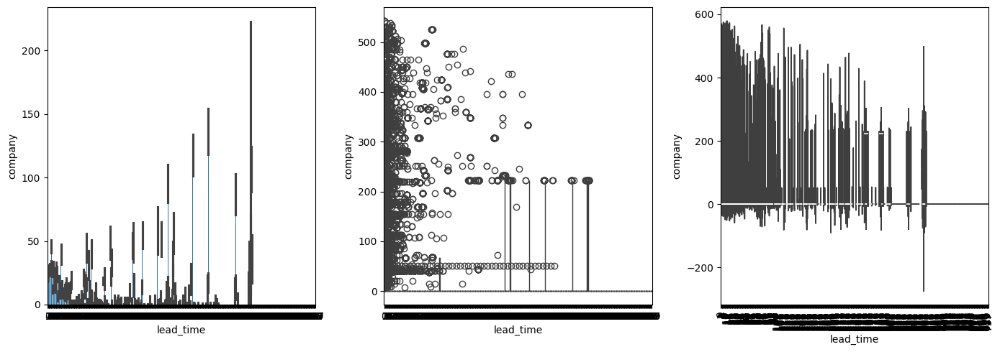

In [ ]:
x = "lead_time"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

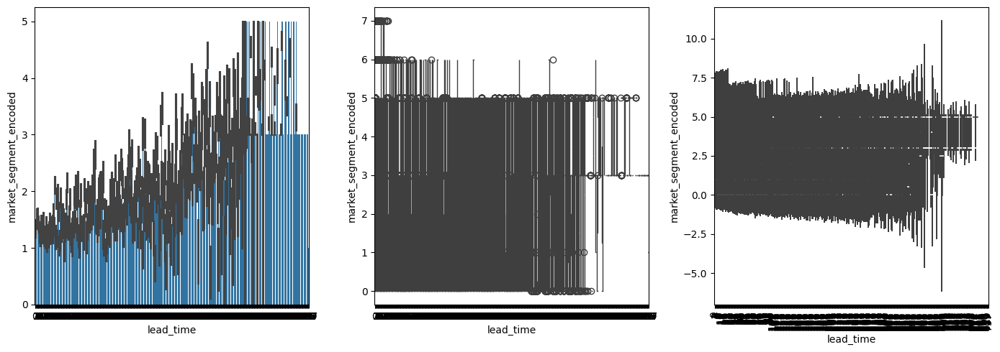

In [ ]:
x = "lead_time"
y = "market_segment_encoded"
plot_distributions(hotel_booking_num_df, x, y)

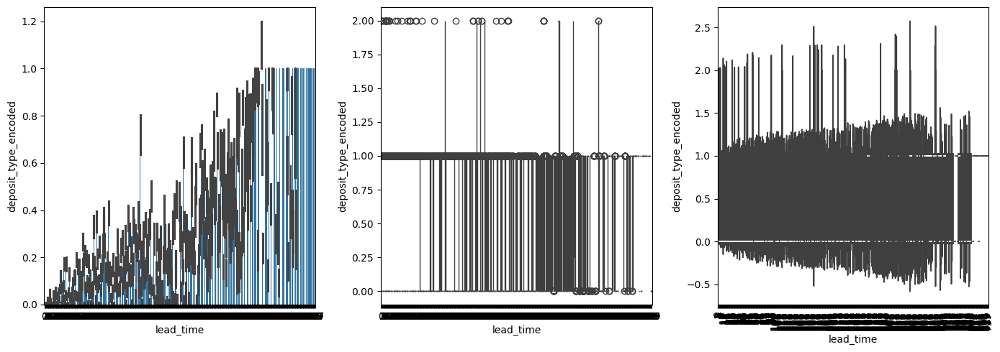

In [ ]:
x = "lead_time"
y = "deposit_type_encoded"
plot_distributions(hotel_booking_num_df, x, y)

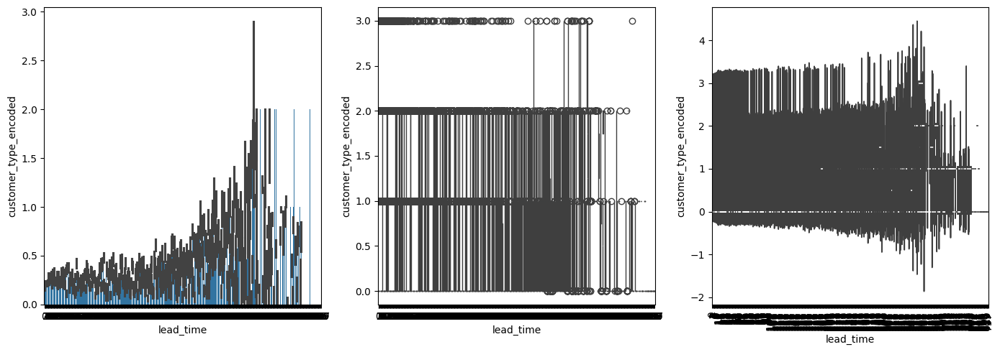

In [ ]:
x = "lead_time"
y = "customer_type_encoded"
plot_distributions(hotel_booking_num_df, x, y)

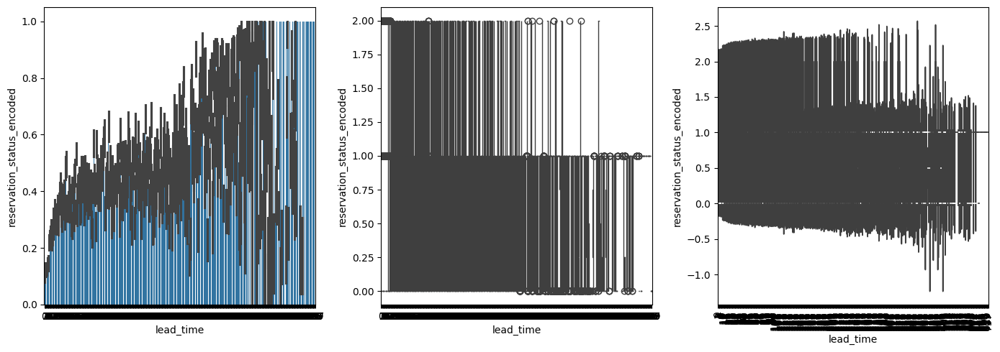

In [ ]:
x = "lead_time"
y = "reservation_status_encoded"
plot_distributions(hotel_booking_num_df, x, y)

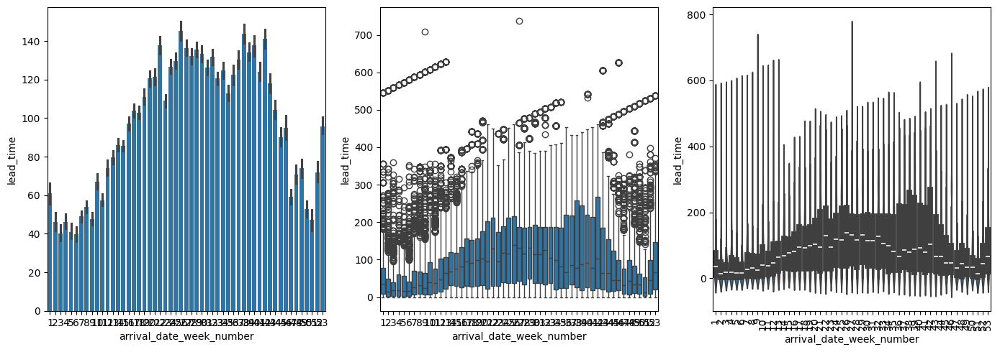

In [ ]:
x = "arrival_date_week_number"
y = "lead_time"
plot_distributions(hotel_booking_num_df, x, y)

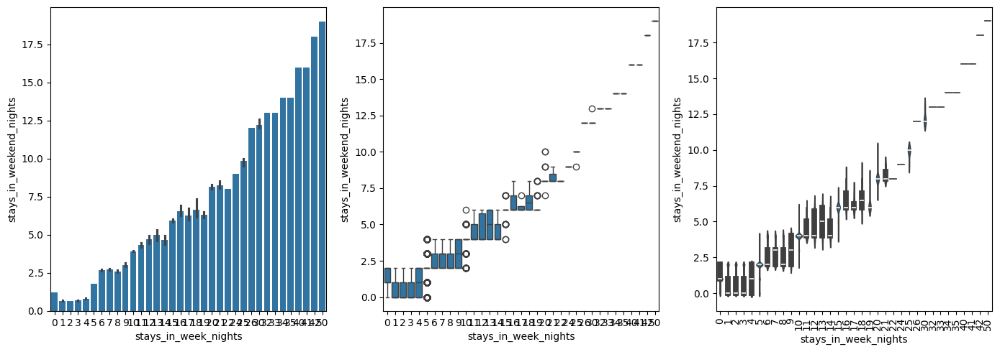

In [ ]:
y = "stays_in_weekend_nights"
x = "stays_in_week_nights"
plot_distributions(hotel_booking_num_df, x, y)

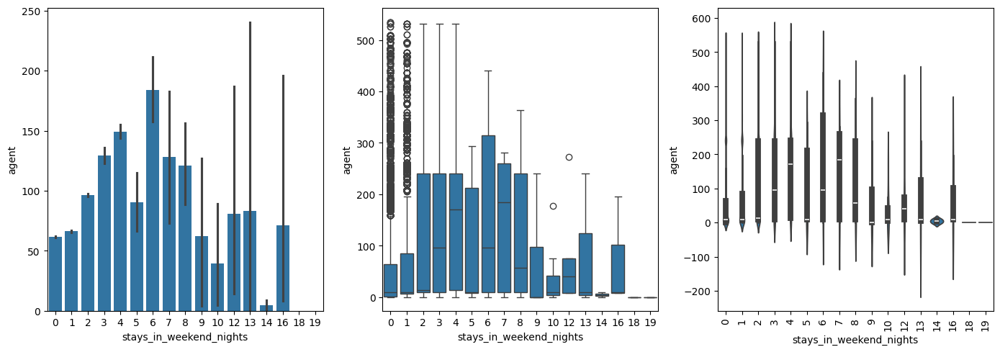

In [ ]:
x = "stays_in_weekend_nights"
y = "agent"
plot_distributions(hotel_booking_num_df, x, y)

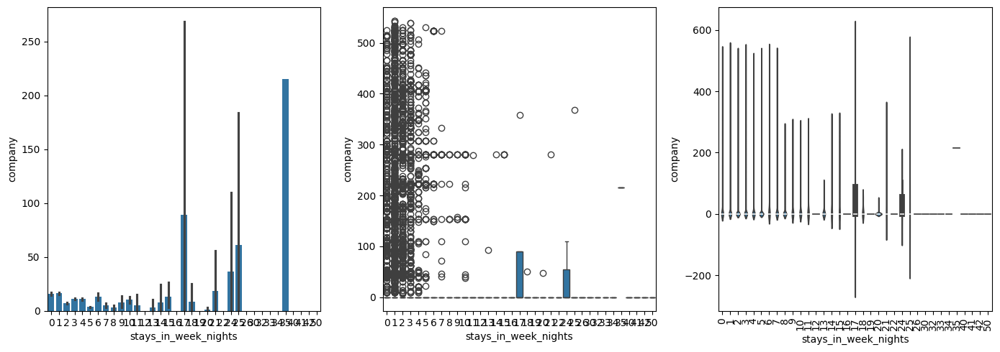

In [ ]:
x = "stays_in_week_nights"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

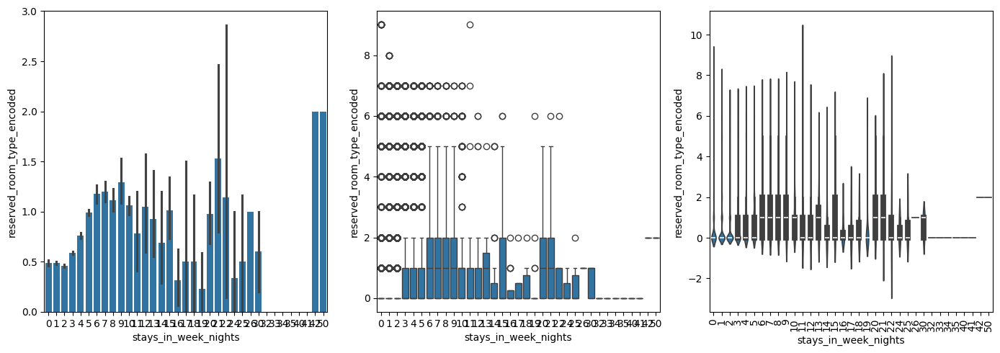

In [ ]:
x = "stays_in_week_nights"
y = "reserved_room_type_encoded"
plot_distributions(hotel_booking_num_df, x, y)

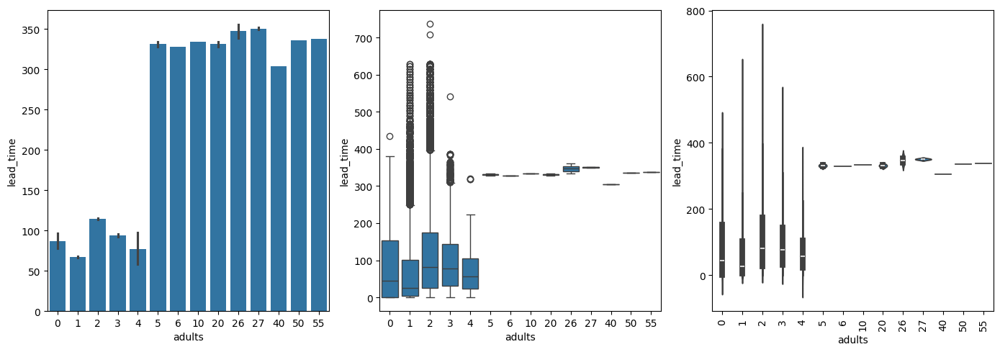

In [ ]:
x = "adults"
y = "lead_time"
plot_distributions(hotel_booking_num_df, x, y)

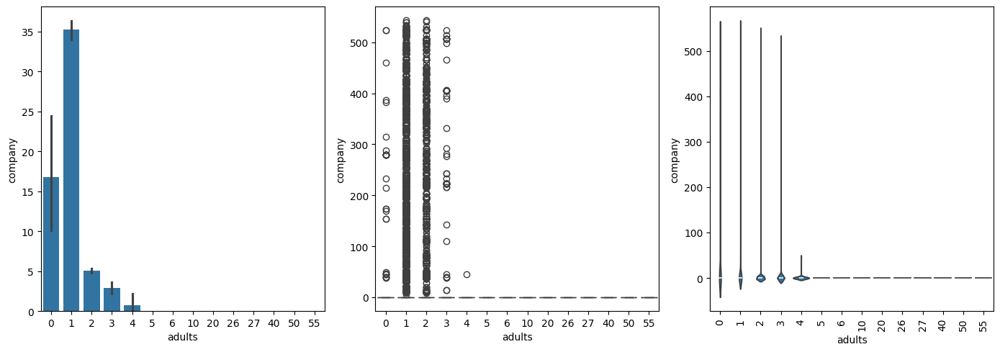

In [ ]:
x = "adults"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

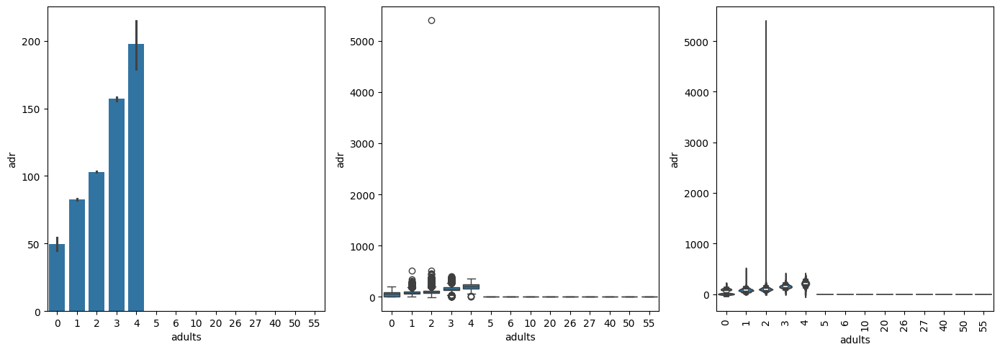

In [ ]:
x = "adults"
y = "adr"
plot_distributions(hotel_booking_num_df, x, y)

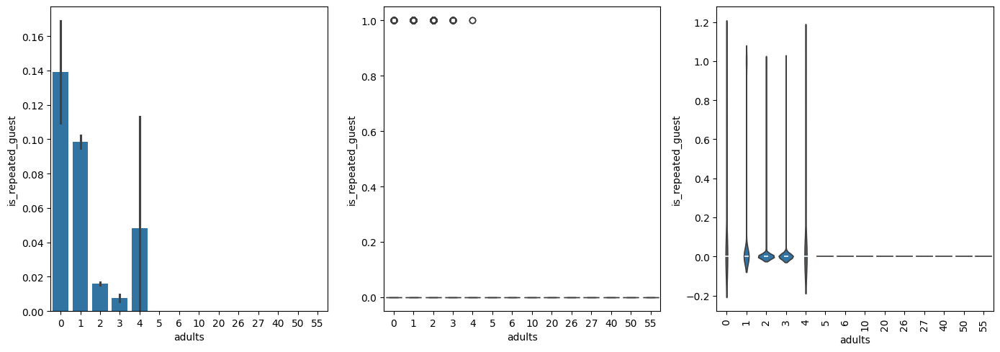

In [ ]:
x = "adults"
y = "is_repeated_guest"
plot_distributions(hotel_booking_num_df, x, y)

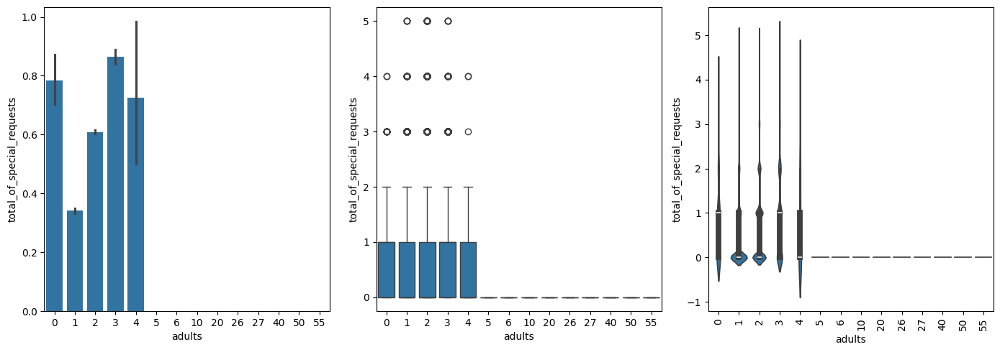

In [ ]:
x = "adults"
y = "total_of_special_requests"
plot_distributions(hotel_booking_num_df, x, y)

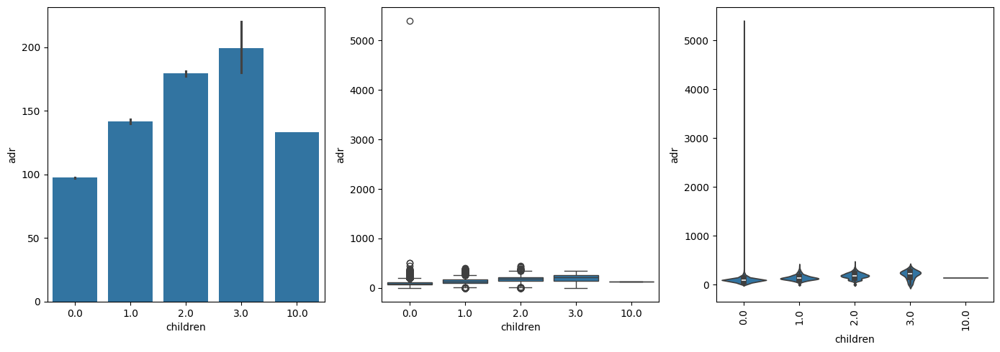

In [ ]:
x = "children"
y = "adr"
plot_distributions(hotel_booking_num_df, x, y)

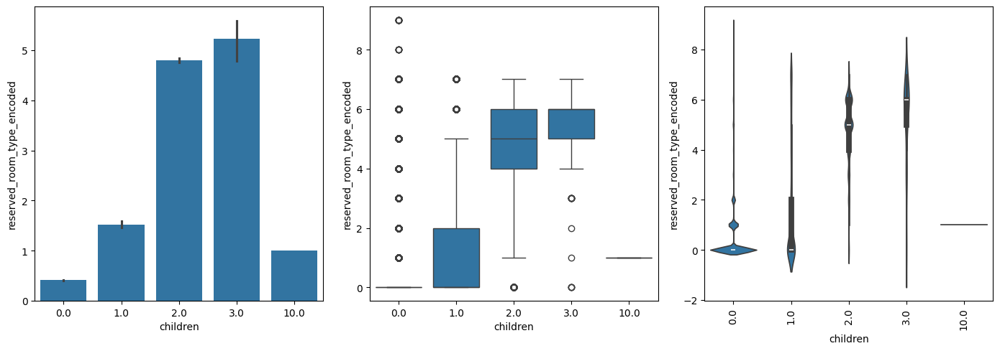

In [ ]:
x = "children"
y = "reserved_room_type_encoded"
plot_distributions(hotel_booking_num_df, x, y)

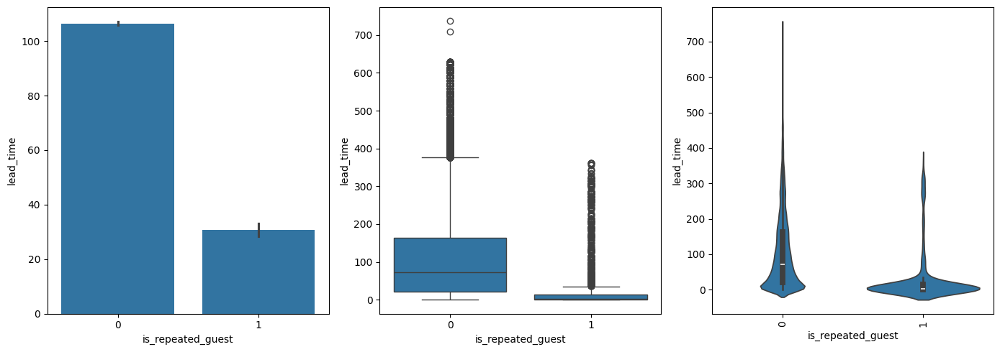

In [ ]:
x = "is_repeated_guest"
y = "lead_time"
plot_distributions(hotel_booking_num_df, x, y)

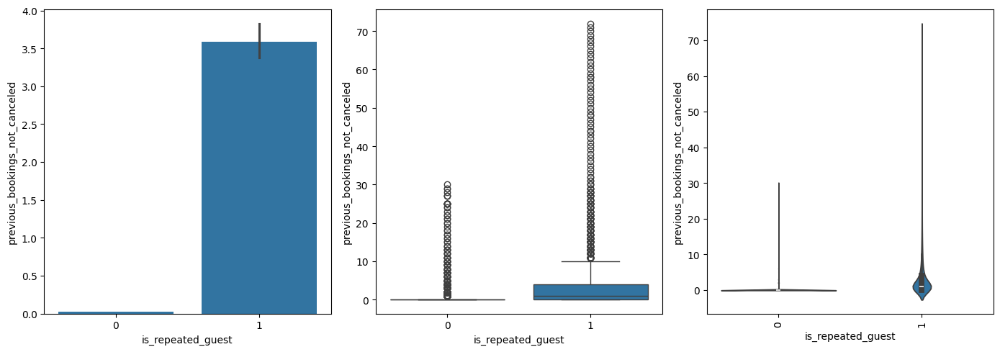

In [ ]:
x = "is_repeated_guest"
y = "previous_bookings_not_canceled"
plot_distributions(hotel_booking_num_df, x, y)

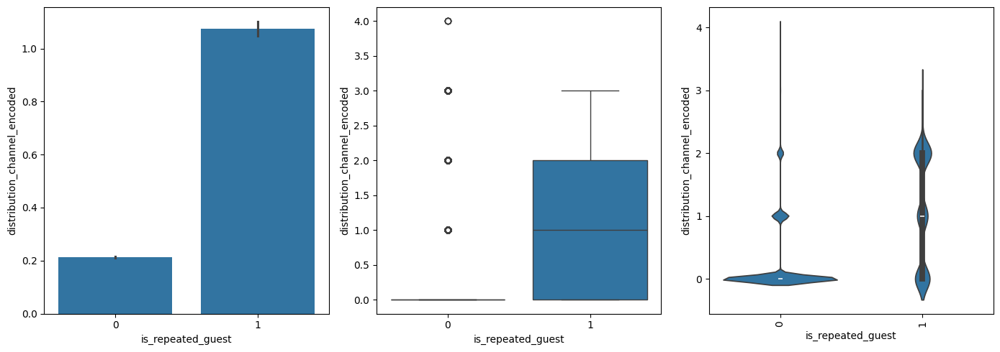

In [ ]:
x = "is_repeated_guest"
y = "distribution_channel_encoded"
plot_distributions(hotel_booking_num_df, x, y)

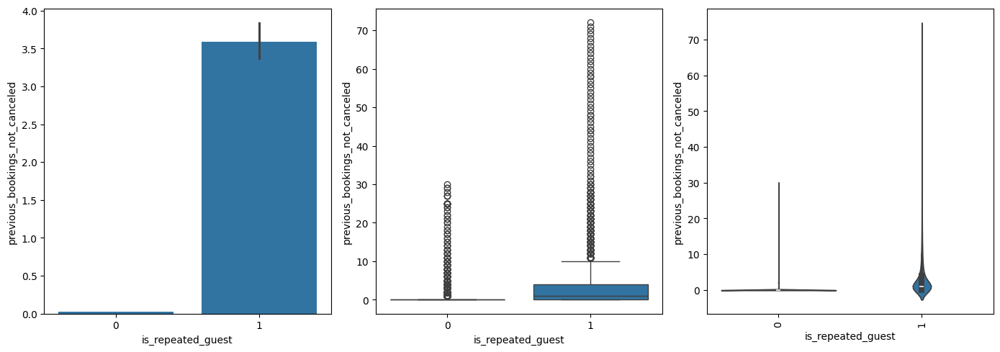

In [ ]:
x = "is_repeated_guest"
y = "previous_bookings_not_canceled"

plot_distributions(hotel_booking_num_df, x, y)

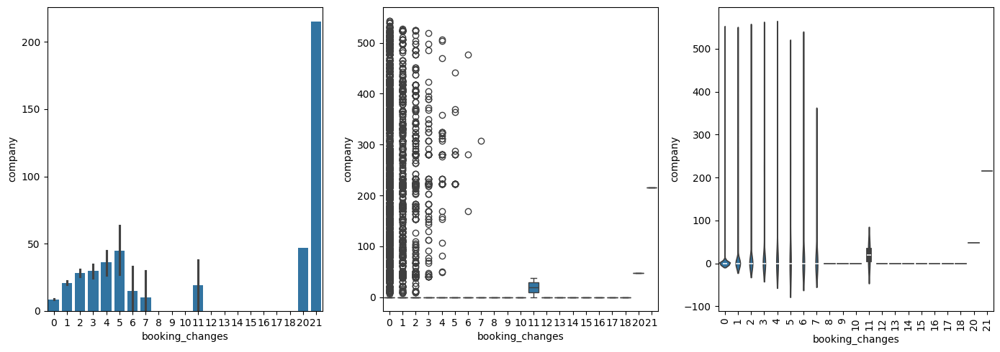

In [ ]:
x = "booking_changes"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)


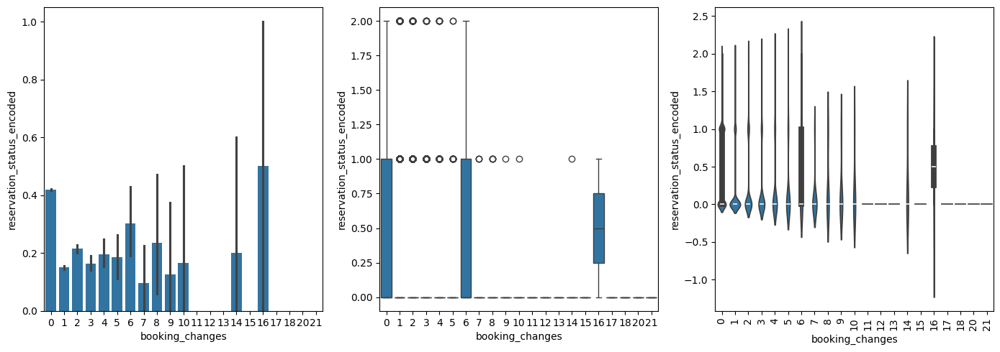

In [ ]:
x = "booking_changes"
y = "reservation_status_encoded"
plot_distributions(hotel_booking_num_df, x, y)

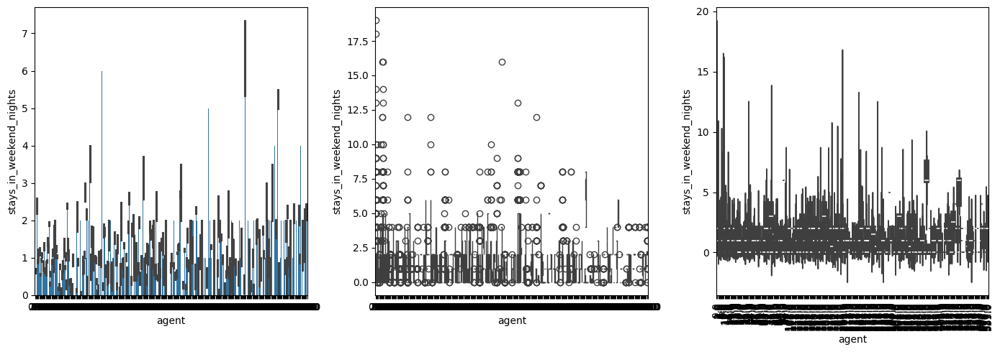

In [ ]:
x = "agent"
y = "stays_in_weekend_nights"
plot_distributions(hotel_booking_num_df, x, y)

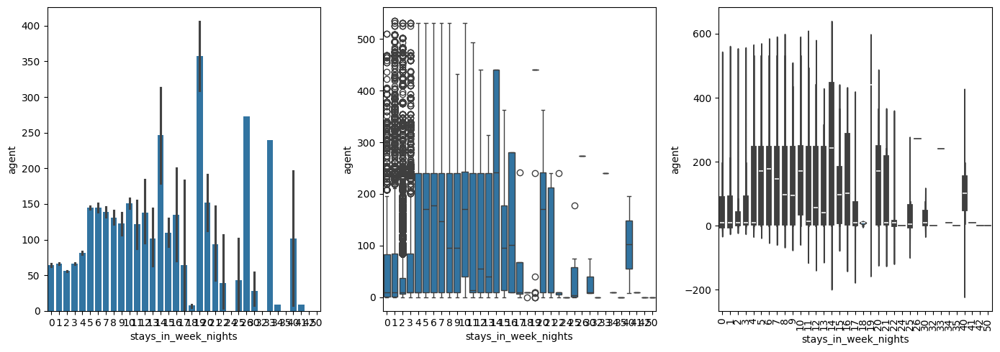

In [ ]:
x = "stays_in_week_nights"
y = "agent"
plot_distributions(hotel_booking_num_df, x, y)

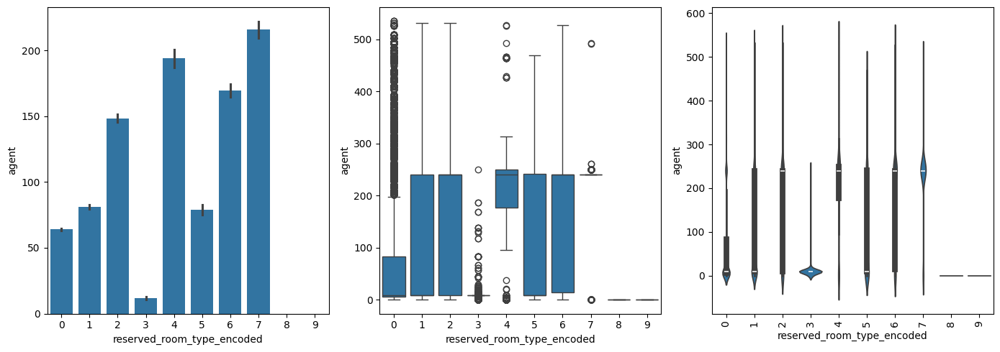

In [ ]:
x = "reserved_room_type_encoded"
y = "agent"
plot_distributions(hotel_booking_num_df, x, y)

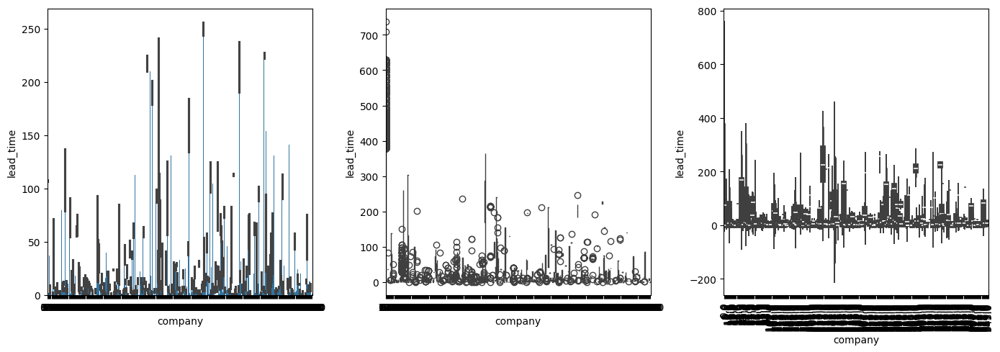

In [ ]:
x = "company"
y = "lead_time"
plot_distributions(hotel_booking_num_df, x, y)

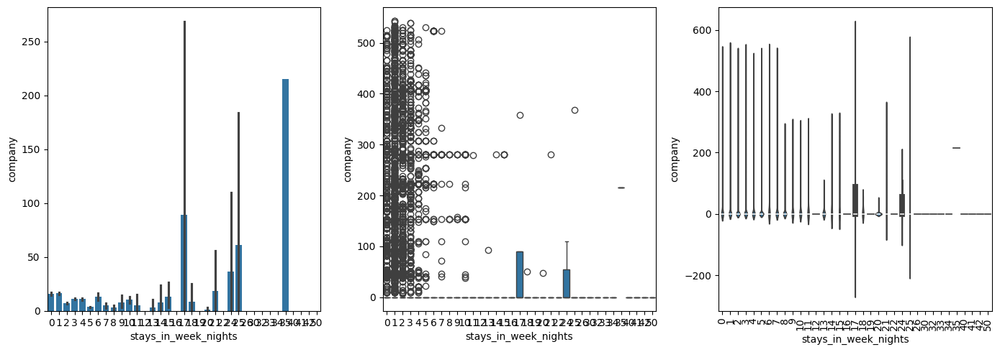

In [ ]:
x = "stays_in_week_nights"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

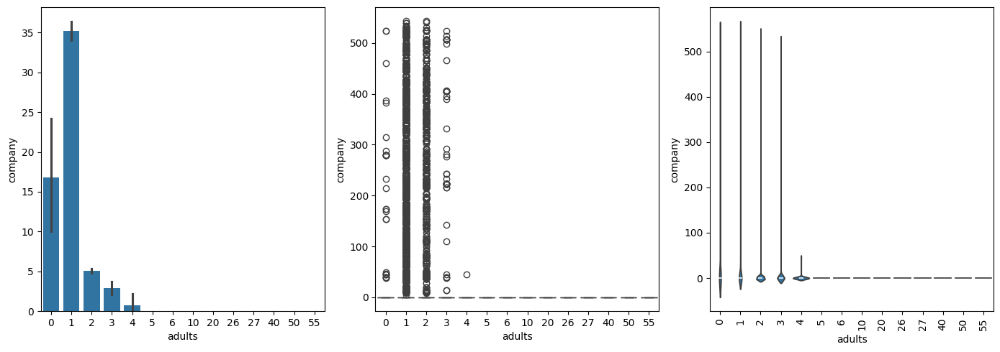

In [ ]:
x = "adults"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

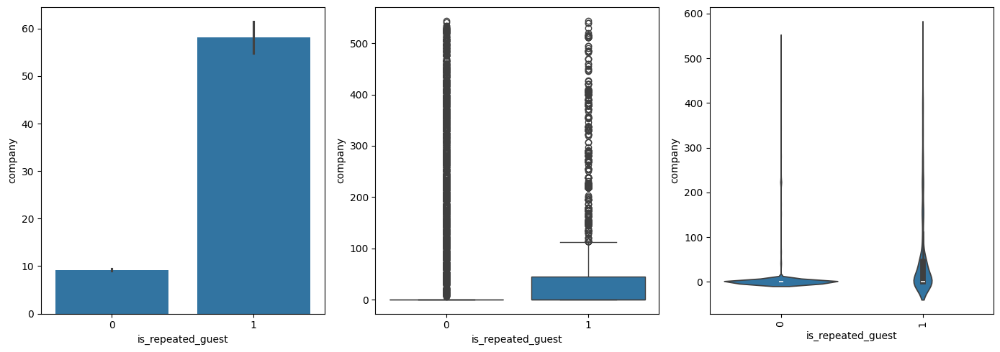

In [ ]:
x = "is_repeated_guest"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

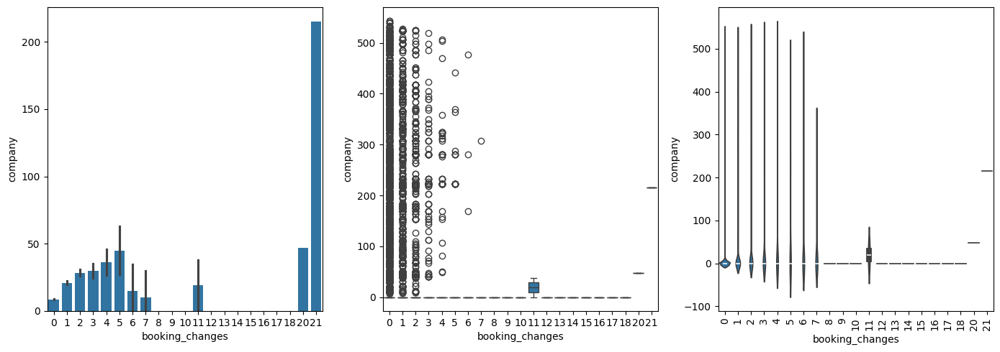

In [ ]:
x = "booking_changes"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

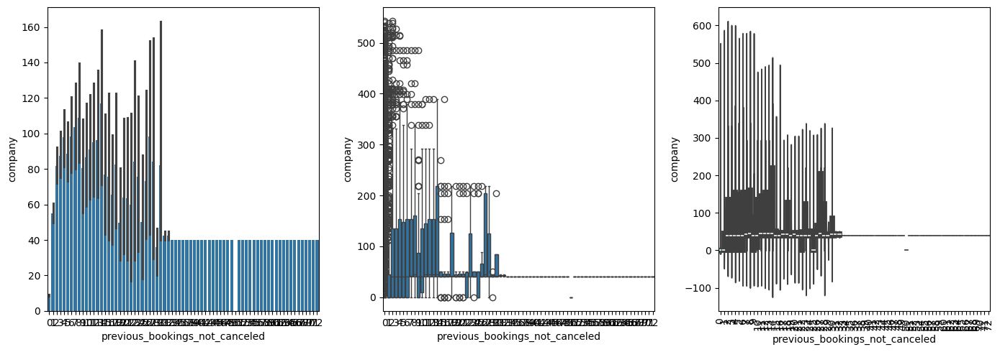

In [ ]:
x = "previous_bookings_not_canceled"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

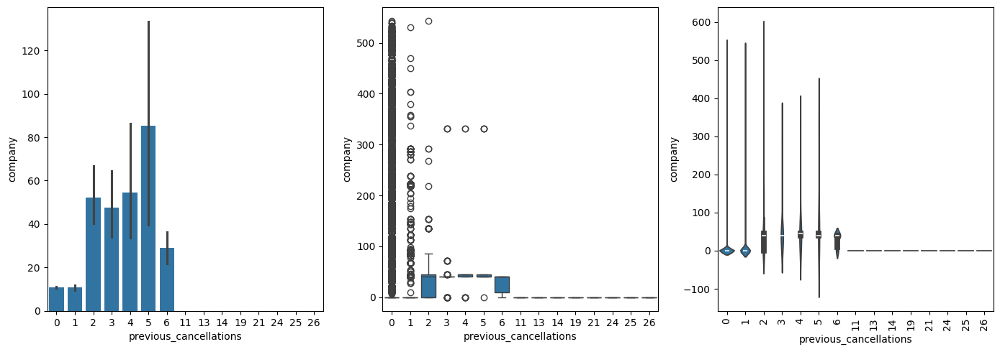

In [ ]:
x = "previous_cancellations"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

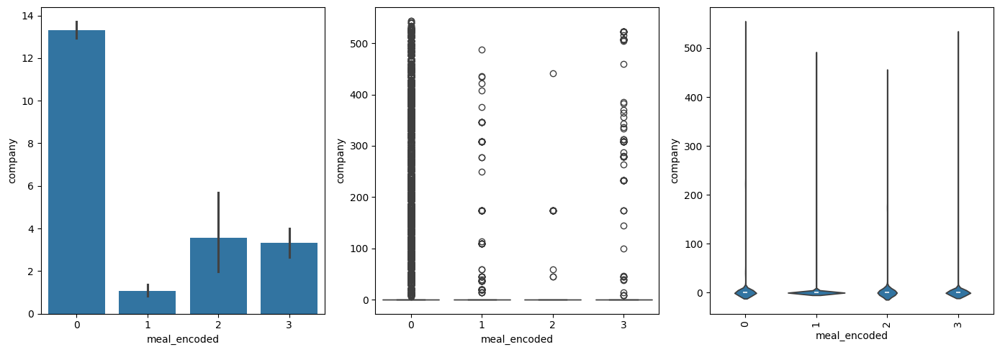

In [ ]:
x = "meal_encoded"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

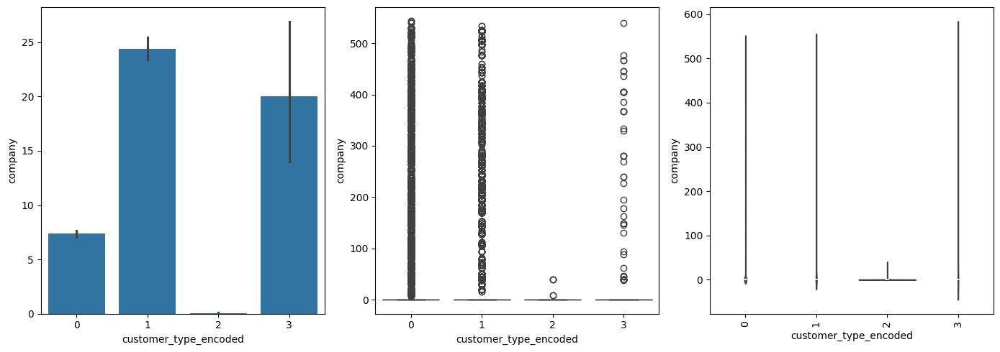

In [ ]:
x = "customer_type_encoded"
y = "company"
plot_distributions(hotel_booking_num_df, x, y)

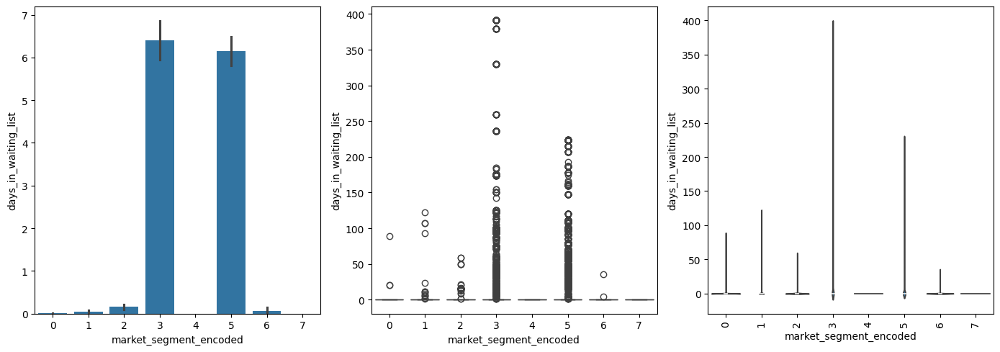

In [ ]:
x = "market_segment_encoded"
y = "days_in_waiting_list"
plot_distributions(hotel_booking_num_df, x, y)

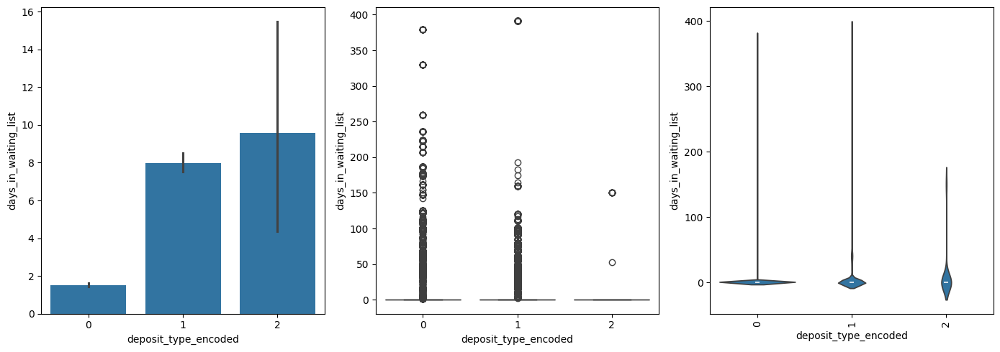

In [ ]:
x = "deposit_type_encoded"
y = "days_in_waiting_list"
plot_distributions(hotel_booking_num_df, x, y)

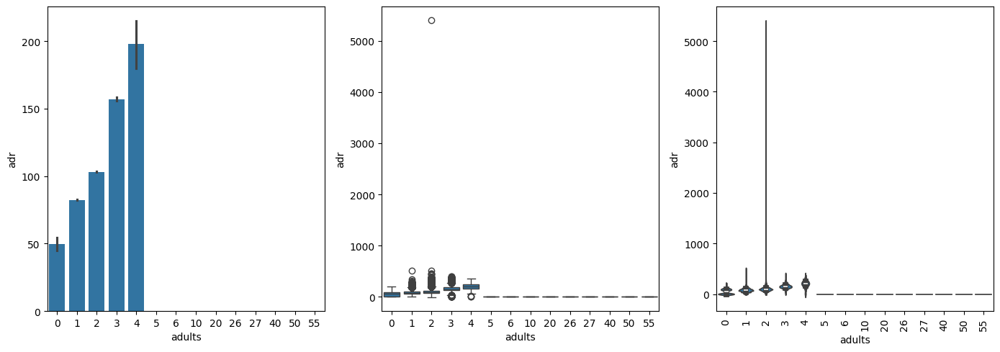

In [ ]:
x = "adults"
y = "adr"
plot_distributions(hotel_booking_num_df, x, y)

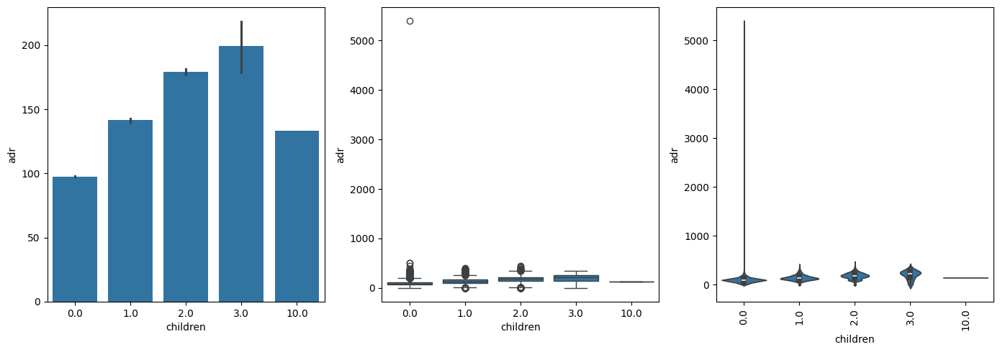

In [ ]:
x = "children"
y = "adr"
plot_distributions(hotel_booking_num_df, x, y)

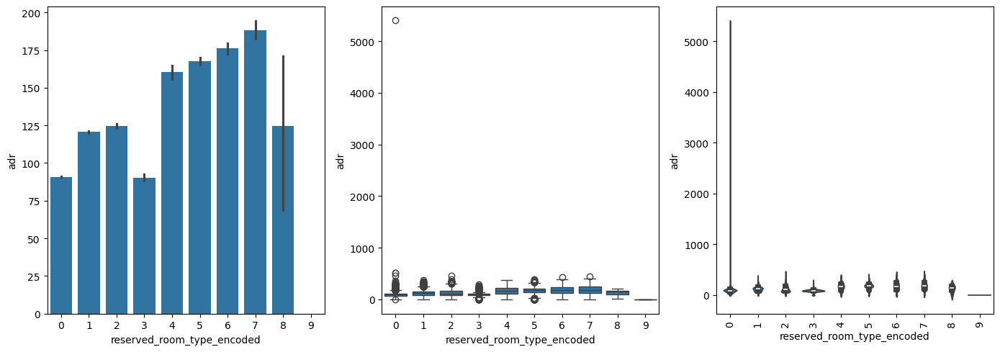

In [ ]:
x = "reserved_room_type_encoded"
y = "adr"
plot_distributions(hotel_booking_num_df, x, y)

Creating training set and test set

In [ ]:
group_by_hotel = hotel_booking_num_df.groupby('hotel_encoded')
hotel_booking_num_h1_df = group_by_hotel.get_group(1)

In [ ]:
#select features and labels
# columns_to_drop = ['reservation_status_encoded', 'is_canceled', 'reservation_status_day', 'reservation_status_month', 'reservation_status_week', 'reservation_status_year', 'adr']
# X = hotel_booking_num_df.loc[:, [column for column in hotel_booking_num_df.columns if column not in columns_to_drop]]
# y = hotel_booking_num_df.loc[:, 'reservation_status_encoded']
df = hotel_booking_num_h1_df
# df = hotel_booking_num_df

columns_to_drop = ['reservation_status_encoded', 'is_canceled', 'reservation_status_day', 'reservation_status_month', 'reservation_status_week', 'reservation_status_year', 'adr']
X = df.loc[:, [column for column in df.columns if column not in columns_to_drop]]
y = df.loc[:, 'reservation_status_encoded']



In [ ]:
#split data into training and test dataframes
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [ ]:
# display(X_train.head(2))
# display(y_train.head(2))
# display(X_test.head(2))
# display(y_test.head(2))

In [ ]:
#create scaler
label_scaler = StandardScaler()

# Scale the features
X_train_scaled = label_scaler.fit_transform(X_train)
X_test_scaled = label_scaler.transform(X_test)

**Model Training and Evaluation**

In [ ]:
# Create a Logistic Regression model
model = LogisticRegression(max_iter=200, random_state=42, C=0.1)

# Train the model
model.fit(X_train_scaled, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

Accuracy: 0.82


In [ ]:
#train model with decision tree:
model = DecisionTreeClassifier(random_state=42)
model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')


Accuracy: 0.87


In [ ]:
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning:


Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.




In [ ]:
#train model using lgbm
lgbm_model = LGBMClassifier(random_state=42)
lgbm_model.fit(X_train_scaled, y_train)
y_pred = lgbm_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007826 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 912
[LightGBM] [Info] Number of data points in the train set: 32048, number of used features: 26
[LightGBM] [Info] Start training from score -0.325672
[LightGBM] [Info] Start training from score -1.307020
[LightGBM] [Info] Start training from score -4.915405
Accuracy: 0.91


/usr/local/lib/python3.10/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



In [ ]:
#train model using xgboost:
xgb_model = XGBClassifier(objective='multi:softmax', random_state=42)
xgb_model.fit(X_train_scaled, y_train)
y_pred = xgb_model.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

Accuracy: 0.91


**Balancing of Labels**

To address imbalance across the labels **Checked out** vs **Cancelled** vs **No show** I will be applying the following techniques:

1. Class weights
2. Oversampling
3. Undersampling

Before applying this techniques the validation loss was actually very high compared to applying this technique.

In [ ]:
# weight_balance = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
# class_labels = np.unique(y_train)
# weight_balance = dict(zip(class_labels, weight_balance))

# random_undersampler = RandomUnderSampler(random_state=42)
# X_train_scaled_resampled, y_train_resampled = random_undersampler.fit_resample(X_train_scaled, y_train)


# smote = RandomOverSampler(random_state=42)  # Or RandomOverSampler(random_state=42)
# X_train_scaled_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)


In [ ]:
#train model with deep learning:
model = keras.Sequential([
    keras.layers.Dense(128, activation='relu'),
    # keras.layers.Dense(64, activation='relu'),

    # keras.layers.Dense(64, activation='relu'),

    keras.layers.Dense(64, activation='relu'),
    layers.Dropout(0.6),  # Drops 40% of features

    keras.layers.Dense(32, activation='relu'),
    # layers.Dropout(0.2),

    keras.layers.Dense(32, activation='relu'),
    # keras.layers.Dense(32, activation='relu'),

    keras.layers.Dense(3, activation='softmax')
])

In [ ]:
#compile model softmax
model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001), loss=keras.losses.SparseCategoricalCrossentropy, metrics=['accuracy'])

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)

In [ ]:
history = model.fit(X_train_scaled, y_train, epochs=150, batch_size=32, validation_split=0.2, callbacks=[early_stopping])
# history = model.fit(X_train_scaled_resampled, y_train_resampled, epochs=50, batch_size=32, validation_split=0.2, callbacks=[])
loss, accuracy = model.evaluate(X_test_scaled, y_test)
print(f'Test Loss: {loss:.4f}')
print(f'Test Accuracy: {accuracy:.4f}')

Epoch 1/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7682 - loss: 0.5289 - val_accuracy: 0.8418 - val_loss: 0.3671
Epoch 2/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8392 - loss: 0.3700 - val_accuracy: 0.8538 - val_loss: 0.3415
Epoch 3/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8493 - loss: 0.3480 - val_accuracy: 0.8565 - val_loss: 0.3330
Epoch 4/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.8579 - loss: 0.3301 - val_accuracy: 0.8562 - val_loss: 0.3279
Epoch 5/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.8632 - loss: 0.3223 - val_accuracy: 0.8598 - val_loss: 0.3266
Epoch 6/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8648 - loss: 0.3177 - val_accuracy: 0.8649 - val_loss: 0.3200
Epoch 7/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.8683 - loss: 0.3096 - val_accuracy: 0.8618 - val_loss: 0.3209
Epoch 8/150
802/802 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.8676 - loss: 0.3034 - val_accu


0.6
Test Loss: 0.2877

Test Accuracy: 0.8849

0.4
Test Loss: 0.3042

Test Accuracy: 0.8840

Test Loss: 0.3091

Test Accuracy: 0.8831


Test Loss: 0.2967

Test Accuracy: 0.8804


Test Loss: 0.2970

Test Accuracy: 0.8774


Test Loss: 0.3758

Test Accuracy: 0.8613

Test Loss: 0.3944

Test Accuracy: 0.8614

Test Loss: 0.3604

Test Accuracy: 0.8612

Test Loss: 0.4388
Test Accuracy: 0.8347

0.005
Test Loss: 0.4536
Test Accuracy: 0.8158

0.0005

Test Loss: 0.4733

Test Accuracy: 0.8243

0.005

Test Loss: 0.3428

Test Accuracy: 0.8561


0.001

8569

l2(0.001)

Test Loss: 0.3534

Test Accuracy: 0.8591


l1(0.001)

Test Loss: 0.3656
Test Accuracy: 0.8626

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score
def scoreMetrics(y_true, y_pred):
  accuracy = accuracy_score(y_true, y_pred)
  precision = precision_score(y_true, y_pred, average='weighted')
  recall = recall_score(y_true, y_pred, average='weighted')
  return accuracy, precision, recall


accuracy, precision, recall = scoreMetrics(y_test, y_pred)
print(f'Test Accuracy: {accuracy:.4f}')
print(f'Test precision: {precision:.4f}')
print(f'Test recall: {recall:.4f}')

Test Accuracy: 0.9069
Test precision: 0.9065
Test recall: 0.9069


special requests e.g
1. private air travel
2. car rentals